# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
from tardis._utils.functions import create_random_mask
import sklearn
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
ratio_true=0.8

mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: 5vu12jj8
Name: old-speeder-148
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/5vu12jj8
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155913-5vu12jj8/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2535,3323,9385
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2535,2582,1689,3386,1667,3384
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4423,10820
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 670,786,2354
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 670,620,419,904,382,815
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1161,2649
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:12<2:08:00, 12.82s/it]

Epoch 1/600:   0%|          | 1/600 [00:12<2:08:00, 12.82s/it, v_num=j8_1, total_loss_train=1.11e+3, kl_local_train=52.5]

Epoch 2/600:   0%|          | 1/600 [00:12<2:08:00, 12.82s/it, v_num=j8_1, total_loss_train=1.11e+3, kl_local_train=52.5]

Epoch 2/600:   0%|          | 2/600 [00:24<2:01:47, 12.22s/it, v_num=j8_1, total_loss_train=1.11e+3, kl_local_train=52.5]

Epoch 2/600:   0%|          | 2/600 [00:24<2:01:47, 12.22s/it, v_num=j8_1, total_loss_train=730, kl_local_train=84.2]    

Epoch 3/600:   0%|          | 2/600 [00:24<2:01:47, 12.22s/it, v_num=j8_1, total_loss_train=730, kl_local_train=84.2]

Epoch 3/600:   0%|          | 3/600 [00:36<1:59:22, 12.00s/it, v_num=j8_1, total_loss_train=730, kl_local_train=84.2]

Epoch 3/600:   0%|          | 3/600 [00:36<1:59:22, 12.00s/it, v_num=j8_1, total_loss_train=697, kl_local_train=86.4]

Epoch 4/600:   0%|          | 3/600 [00:36<1:59:22, 12.00s/it, v_num=j8_1, total_loss_train=697, kl_local_train=86.4]

Epoch 4/600:   1%|          | 4/600 [00:48<1:58:13, 11.90s/it, v_num=j8_1, total_loss_train=697, kl_local_train=86.4]

Epoch 4/600:   1%|          | 4/600 [00:48<1:58:13, 11.90s/it, v_num=j8_1, total_loss_train=688, kl_local_train=81]  

Epoch 5/600:   1%|          | 4/600 [00:48<1:58:13, 11.90s/it, v_num=j8_1, total_loss_train=688, kl_local_train=81]

Epoch 5/600:   1%|          | 5/600 [00:59<1:57:39, 11.87s/it, v_num=j8_1, total_loss_train=688, kl_local_train=81]

Epoch 5/600:   1%|          | 5/600 [00:59<1:57:39, 11.87s/it, v_num=j8_1, total_loss_train=684, kl_local_train=70.9]

Epoch 6/600:   1%|          | 5/600 [01:01<1:57:39, 11.87s/it, v_num=j8_1, total_loss_train=684, kl_local_train=70.9]

Epoch 6/600:   1%|          | 6/600 [01:12<1:59:16, 12.05s/it, v_num=j8_1, total_loss_train=684, kl_local_train=70.9]

Epoch 6/600:   1%|          | 6/600 [01:12<1:59:16, 12.05s/it, v_num=j8_1, total_loss_train=681, kl_local_train=57.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:12<1:59:16, 12.05s/it, v_num=j8_1, total_loss_train=681, kl_local_train=57.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:23<1:56:32, 11.79s/it, v_num=j8_1, total_loss_train=681, kl_local_train=57.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:23<1:56:32, 11.79s/it, v_num=j8_1, total_loss_train=680, kl_local_train=42.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:23<1:56:32, 11.79s/it, v_num=j8_1, total_loss_train=680, kl_local_train=42.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:34<1:54:32, 11.61s/it, v_num=j8_1, total_loss_train=680, kl_local_train=42.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:34<1:54:32, 11.61s/it, v_num=j8_1, total_loss_train=687, kl_local_train=25.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:34<1:54:32, 11.61s/it, v_num=j8_1, total_loss_train=687, kl_local_train=25.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:45<1:52:58, 11.47s/it, v_num=j8_1, total_loss_train=687, kl_local_train=25.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:45<1:52:58, 11.47s/it, v_num=j8_1, total_loss_train=694, kl_local_train=18.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [01:45<1:52:58, 11.47s/it, v_num=j8_1, total_loss_train=694, kl_local_train=18.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [01:57<1:52:16, 11.42s/it, v_num=j8_1, total_loss_train=694, kl_local_train=18.7, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [01:57<1:52:16, 11.42s/it, v_num=j8_1, total_loss_train=701, kl_local_train=15.3, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 10/600 [01:58<1:52:16, 11.42s/it, v_num=j8_1, total_loss_train=701, kl_local_train=15.3, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:09<1:55:06, 11.73s/it, v_num=j8_1, total_loss_train=701, kl_local_train=15.3, metric_mi|status_control_train=0.0181, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:09<1:55:06, 11.73s/it, v_num=j8_1, total_loss_train=708, kl_local_train=17.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 12/600:   2%|▏         | 11/600 [02:09<1:55:06, 11.73s/it, v_num=j8_1, total_loss_train=708, kl_local_train=17.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 12/600:   2%|▏         | 12/600 [02:20<1:53:17, 11.56s/it, v_num=j8_1, total_loss_train=708, kl_local_train=17.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 12/600:   2%|▏         | 12/600 [02:20<1:53:17, 11.56s/it, v_num=j8_1, total_loss_train=715, kl_local_train=46.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 13/600:   2%|▏         | 12/600 [02:20<1:53:17, 11.56s/it, v_num=j8_1, total_loss_train=715, kl_local_train=46.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 13/600:   2%|▏         | 13/600 [02:32<1:51:55, 11.44s/it, v_num=j8_1, total_loss_train=715, kl_local_train=46.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 13/600:   2%|▏         | 13/600 [02:32<1:51:55, 11.44s/it, v_num=j8_1, total_loss_train=718, kl_local_train=121, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351] 

Epoch 14/600:   2%|▏         | 13/600 [02:32<1:51:55, 11.44s/it, v_num=j8_1, total_loss_train=718, kl_local_train=121, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 14/600:   2%|▏         | 14/600 [02:43<1:50:58, 11.36s/it, v_num=j8_1, total_loss_train=718, kl_local_train=121, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 14/600:   2%|▏         | 14/600 [02:43<1:50:58, 11.36s/it, v_num=j8_1, total_loss_train=721, kl_local_train=90.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 15/600:   2%|▏         | 14/600 [02:43<1:50:58, 11.36s/it, v_num=j8_1, total_loss_train=721, kl_local_train=90.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 15/600:   2%|▎         | 15/600 [02:54<1:50:31, 11.34s/it, v_num=j8_1, total_loss_train=721, kl_local_train=90.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 15/600:   2%|▎         | 15/600 [02:54<1:50:31, 11.34s/it, v_num=j8_1, total_loss_train=725, kl_local_train=80, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]  

Epoch 16/600:   2%|▎         | 15/600 [02:55<1:50:31, 11.34s/it, v_num=j8_1, total_loss_train=725, kl_local_train=80, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 16/600:   3%|▎         | 16/600 [03:06<1:53:36, 11.67s/it, v_num=j8_1, total_loss_train=725, kl_local_train=80, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00839, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 16/600:   3%|▎         | 16/600 [03:06<1:53:36, 11.67s/it, v_num=j8_1, total_loss_train=726, kl_local_train=122, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404] 

Epoch 17/600:   3%|▎         | 16/600 [03:06<1:53:36, 11.67s/it, v_num=j8_1, total_loss_train=726, kl_local_train=122, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 17/600:   3%|▎         | 17/600 [03:18<1:51:56, 11.52s/it, v_num=j8_1, total_loss_train=726, kl_local_train=122, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 17/600:   3%|▎         | 17/600 [03:18<1:51:56, 11.52s/it, v_num=j8_1, total_loss_train=727, kl_local_train=123, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 18/600:   3%|▎         | 17/600 [03:18<1:51:56, 11.52s/it, v_num=j8_1, total_loss_train=727, kl_local_train=123, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 18/600:   3%|▎         | 18/600 [03:29<1:50:43, 11.41s/it, v_num=j8_1, total_loss_train=727, kl_local_train=123, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 18/600:   3%|▎         | 18/600 [03:29<1:50:43, 11.41s/it, v_num=j8_1, total_loss_train=729, kl_local_train=119, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 19/600:   3%|▎         | 18/600 [03:29<1:50:43, 11.41s/it, v_num=j8_1, total_loss_train=729, kl_local_train=119, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 19/600:   3%|▎         | 19/600 [03:40<1:49:48, 11.34s/it, v_num=j8_1, total_loss_train=729, kl_local_train=119, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 19/600:   3%|▎         | 19/600 [03:40<1:49:48, 11.34s/it, v_num=j8_1, total_loss_train=732, kl_local_train=116, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 20/600:   3%|▎         | 19/600 [03:40<1:49:48, 11.34s/it, v_num=j8_1, total_loss_train=732, kl_local_train=116, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 20/600:   3%|▎         | 20/600 [03:51<1:49:31, 11.33s/it, v_num=j8_1, total_loss_train=732, kl_local_train=116, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 20/600:   3%|▎         | 20/600 [03:51<1:49:31, 11.33s/it, v_num=j8_1, total_loss_train=735, kl_local_train=117, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 21/600:   3%|▎         | 20/600 [03:52<1:49:31, 11.33s/it, v_num=j8_1, total_loss_train=735, kl_local_train=117, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 21/600:   4%|▎         | 21/600 [04:04<1:52:44, 11.68s/it, v_num=j8_1, total_loss_train=735, kl_local_train=117, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.186, metric_mi|time_cat_train=0.0168, metric_mi|mouse_train=0.0404]

Epoch 21/600:   4%|▎         | 21/600 [04:04<1:52:44, 11.68s/it, v_num=j8_1, total_loss_train=739, kl_local_train=117, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763] 

Epoch 22/600:   4%|▎         | 21/600 [04:04<1:52:44, 11.68s/it, v_num=j8_1, total_loss_train=739, kl_local_train=117, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 22/600:   4%|▎         | 22/600 [04:15<1:51:25, 11.57s/it, v_num=j8_1, total_loss_train=739, kl_local_train=117, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 22/600:   4%|▎         | 22/600 [04:15<1:51:25, 11.57s/it, v_num=j8_1, total_loss_train=741, kl_local_train=129, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 23/600:   4%|▎         | 22/600 [04:15<1:51:25, 11.57s/it, v_num=j8_1, total_loss_train=741, kl_local_train=129, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 23/600:   4%|▍         | 23/600 [04:26<1:50:30, 11.49s/it, v_num=j8_1, total_loss_train=741, kl_local_train=129, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 23/600:   4%|▍         | 23/600 [04:26<1:50:30, 11.49s/it, v_num=j8_1, total_loss_train=741, kl_local_train=140, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 24/600:   4%|▍         | 23/600 [04:26<1:50:30, 11.49s/it, v_num=j8_1, total_loss_train=741, kl_local_train=140, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 24/600:   4%|▍         | 24/600 [04:38<1:49:40, 11.42s/it, v_num=j8_1, total_loss_train=741, kl_local_train=140, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 24/600:   4%|▍         | 24/600 [04:38<1:49:40, 11.42s/it, v_num=j8_1, total_loss_train=742, kl_local_train=141, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 25/600:   4%|▍         | 24/600 [04:38<1:49:40, 11.42s/it, v_num=j8_1, total_loss_train=742, kl_local_train=141, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 25/600:   4%|▍         | 25/600 [04:49<1:50:14, 11.50s/it, v_num=j8_1, total_loss_train=742, kl_local_train=141, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 25/600:   4%|▍         | 25/600 [04:49<1:50:14, 11.50s/it, v_num=j8_1, total_loss_train=744, kl_local_train=145, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 26/600:   4%|▍         | 25/600 [04:51<1:50:14, 11.50s/it, v_num=j8_1, total_loss_train=744, kl_local_train=145, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 26/600:   4%|▍         | 26/600 [05:02<1:53:04, 11.82s/it, v_num=j8_1, total_loss_train=744, kl_local_train=145, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.189, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0763]

Epoch 26/600:   4%|▍         | 26/600 [05:02<1:53:04, 11.82s/it, v_num=j8_1, total_loss_train=747, kl_local_train=147, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]  

Epoch 27/600:   4%|▍         | 26/600 [05:02<1:53:04, 11.82s/it, v_num=j8_1, total_loss_train=747, kl_local_train=147, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 27/600:   4%|▍         | 27/600 [05:13<1:51:13, 11.65s/it, v_num=j8_1, total_loss_train=747, kl_local_train=147, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 27/600:   4%|▍         | 27/600 [05:13<1:51:13, 11.65s/it, v_num=j8_1, total_loss_train=750, kl_local_train=151, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 28/600:   4%|▍         | 27/600 [05:13<1:51:13, 11.65s/it, v_num=j8_1, total_loss_train=750, kl_local_train=151, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 28/600:   5%|▍         | 28/600 [05:24<1:49:50, 11.52s/it, v_num=j8_1, total_loss_train=750, kl_local_train=151, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 28/600:   5%|▍         | 28/600 [05:24<1:49:50, 11.52s/it, v_num=j8_1, total_loss_train=753, kl_local_train=150, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 29/600:   5%|▍         | 28/600 [05:24<1:49:50, 11.52s/it, v_num=j8_1, total_loss_train=753, kl_local_train=150, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 29/600:   5%|▍         | 29/600 [05:36<1:48:50, 11.44s/it, v_num=j8_1, total_loss_train=753, kl_local_train=150, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 29/600:   5%|▍         | 29/600 [05:36<1:48:50, 11.44s/it, v_num=j8_1, total_loss_train=756, kl_local_train=148, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 30/600:   5%|▍         | 29/600 [05:36<1:48:50, 11.44s/it, v_num=j8_1, total_loss_train=756, kl_local_train=148, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 30/600:   5%|▌         | 30/600 [05:47<1:48:08, 11.38s/it, v_num=j8_1, total_loss_train=756, kl_local_train=148, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 30/600:   5%|▌         | 30/600 [05:47<1:48:08, 11.38s/it, v_num=j8_1, total_loss_train=760, kl_local_train=148, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 31/600:   5%|▌         | 30/600 [05:48<1:48:08, 11.38s/it, v_num=j8_1, total_loss_train=760, kl_local_train=148, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 31/600:   5%|▌         | 31/600 [05:59<1:51:05, 11.71s/it, v_num=j8_1, total_loss_train=760, kl_local_train=148, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.123]

Epoch 31/600:   5%|▌         | 31/600 [05:59<1:51:05, 11.71s/it, v_num=j8_1, total_loss_train=763, kl_local_train=148, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135] 

Epoch 32/600:   5%|▌         | 31/600 [05:59<1:51:05, 11.71s/it, v_num=j8_1, total_loss_train=763, kl_local_train=148, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 32/600:   5%|▌         | 32/600 [06:11<1:49:31, 11.57s/it, v_num=j8_1, total_loss_train=763, kl_local_train=148, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 32/600:   5%|▌         | 32/600 [06:11<1:49:31, 11.57s/it, v_num=j8_1, total_loss_train=767, kl_local_train=150, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 33/600:   5%|▌         | 32/600 [06:11<1:49:31, 11.57s/it, v_num=j8_1, total_loss_train=767, kl_local_train=150, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 33/600:   6%|▌         | 33/600 [06:22<1:48:26, 11.47s/it, v_num=j8_1, total_loss_train=767, kl_local_train=150, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 33/600:   6%|▌         | 33/600 [06:22<1:48:26, 11.47s/it, v_num=j8_1, total_loss_train=770, kl_local_train=150, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 34/600:   6%|▌         | 33/600 [06:22<1:48:26, 11.47s/it, v_num=j8_1, total_loss_train=770, kl_local_train=150, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 34/600:   6%|▌         | 34/600 [06:33<1:47:38, 11.41s/it, v_num=j8_1, total_loss_train=770, kl_local_train=150, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 34/600:   6%|▌         | 34/600 [06:33<1:47:38, 11.41s/it, v_num=j8_1, total_loss_train=774, kl_local_train=149, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 35/600:   6%|▌         | 34/600 [06:33<1:47:38, 11.41s/it, v_num=j8_1, total_loss_train=774, kl_local_train=149, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 35/600:   6%|▌         | 35/600 [06:44<1:47:17, 11.39s/it, v_num=j8_1, total_loss_train=774, kl_local_train=149, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 35/600:   6%|▌         | 35/600 [06:44<1:47:17, 11.39s/it, v_num=j8_1, total_loss_train=778, kl_local_train=153, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 36/600:   6%|▌         | 35/600 [06:46<1:47:17, 11.39s/it, v_num=j8_1, total_loss_train=778, kl_local_train=153, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 36/600:   6%|▌         | 36/600 [06:57<1:50:10, 11.72s/it, v_num=j8_1, total_loss_train=778, kl_local_train=153, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.135]

Epoch 36/600:   6%|▌         | 36/600 [06:57<1:50:10, 11.72s/it, v_num=j8_1, total_loss_train=782, kl_local_train=153, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 36/600 [06:57<1:50:10, 11.72s/it, v_num=j8_1, total_loss_train=782, kl_local_train=153, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [07:08<1:48:37, 11.58s/it, v_num=j8_1, total_loss_train=782, kl_local_train=153, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [07:08<1:48:37, 11.58s/it, v_num=j8_1, total_loss_train=785, kl_local_train=151, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▌         | 37/600 [07:08<1:48:37, 11.58s/it, v_num=j8_1, total_loss_train=785, kl_local_train=151, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [07:19<1:47:32, 11.48s/it, v_num=j8_1, total_loss_train=785, kl_local_train=151, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [07:19<1:47:32, 11.48s/it, v_num=j8_1, total_loss_train=789, kl_local_train=154, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 38/600 [07:19<1:47:32, 11.48s/it, v_num=j8_1, total_loss_train=789, kl_local_train=154, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [07:31<1:46:42, 11.41s/it, v_num=j8_1, total_loss_train=789, kl_local_train=154, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [07:31<1:46:42, 11.41s/it, v_num=j8_1, total_loss_train=793, kl_local_train=152, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 40/600:   6%|▋         | 39/600 [07:31<1:46:42, 11.41s/it, v_num=j8_1, total_loss_train=793, kl_local_train=152, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [07:42<1:46:21, 11.40s/it, v_num=j8_1, total_loss_train=793, kl_local_train=152, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [07:42<1:46:21, 11.40s/it, v_num=j8_1, total_loss_train=797, kl_local_train=153, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 40/600 [07:43<1:46:21, 11.40s/it, v_num=j8_1, total_loss_train=797, kl_local_train=153, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [07:55<1:49:21, 11.74s/it, v_num=j8_1, total_loss_train=797, kl_local_train=153, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [07:55<1:49:21, 11.74s/it, v_num=j8_1, total_loss_train=801, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139] 

Epoch 42/600:   7%|▋         | 41/600 [07:55<1:49:21, 11.74s/it, v_num=j8_1, total_loss_train=801, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 42/600:   7%|▋         | 42/600 [08:06<1:47:53, 11.60s/it, v_num=j8_1, total_loss_train=801, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 42/600:   7%|▋         | 42/600 [08:06<1:47:53, 11.60s/it, v_num=j8_1, total_loss_train=805, kl_local_train=151, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 43/600:   7%|▋         | 42/600 [08:06<1:47:53, 11.60s/it, v_num=j8_1, total_loss_train=805, kl_local_train=151, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 43/600:   7%|▋         | 43/600 [08:17<1:46:42, 11.49s/it, v_num=j8_1, total_loss_train=805, kl_local_train=151, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 43/600:   7%|▋         | 43/600 [08:17<1:46:42, 11.49s/it, v_num=j8_1, total_loss_train=809, kl_local_train=155, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 44/600:   7%|▋         | 43/600 [08:17<1:46:42, 11.49s/it, v_num=j8_1, total_loss_train=809, kl_local_train=155, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 44/600:   7%|▋         | 44/600 [08:28<1:45:52, 11.43s/it, v_num=j8_1, total_loss_train=809, kl_local_train=155, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 44/600:   7%|▋         | 44/600 [08:28<1:45:52, 11.43s/it, v_num=j8_1, total_loss_train=812, kl_local_train=153, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 45/600:   7%|▋         | 44/600 [08:28<1:45:52, 11.43s/it, v_num=j8_1, total_loss_train=812, kl_local_train=153, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 45/600:   8%|▊         | 45/600 [08:40<1:45:13, 11.37s/it, v_num=j8_1, total_loss_train=812, kl_local_train=153, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 45/600:   8%|▊         | 45/600 [08:40<1:45:13, 11.37s/it, v_num=j8_1, total_loss_train=816, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 46/600:   8%|▊         | 45/600 [08:41<1:45:13, 11.37s/it, v_num=j8_1, total_loss_train=816, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 46/600:   8%|▊         | 46/600 [08:52<1:48:13, 11.72s/it, v_num=j8_1, total_loss_train=816, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 46/600:   8%|▊         | 46/600 [08:52<1:48:13, 11.72s/it, v_num=j8_1, total_loss_train=820, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 47/600:   8%|▊         | 46/600 [08:52<1:48:13, 11.72s/it, v_num=j8_1, total_loss_train=820, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 47/600:   8%|▊         | 47/600 [09:03<1:46:53, 11.60s/it, v_num=j8_1, total_loss_train=820, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 47/600:   8%|▊         | 47/600 [09:03<1:46:53, 11.60s/it, v_num=j8_1, total_loss_train=824, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 48/600:   8%|▊         | 47/600 [09:03<1:46:53, 11.60s/it, v_num=j8_1, total_loss_train=824, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 48/600:   8%|▊         | 48/600 [09:15<1:46:10, 11.54s/it, v_num=j8_1, total_loss_train=824, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 48/600:   8%|▊         | 48/600 [09:15<1:46:10, 11.54s/it, v_num=j8_1, total_loss_train=827, kl_local_train=155, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 49/600:   8%|▊         | 48/600 [09:15<1:46:10, 11.54s/it, v_num=j8_1, total_loss_train=827, kl_local_train=155, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 49/600:   8%|▊         | 49/600 [09:26<1:45:14, 11.46s/it, v_num=j8_1, total_loss_train=827, kl_local_train=155, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 49/600:   8%|▊         | 49/600 [09:26<1:45:14, 11.46s/it, v_num=j8_1, total_loss_train=831, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 50/600:   8%|▊         | 49/600 [09:26<1:45:14, 11.46s/it, v_num=j8_1, total_loss_train=831, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 50/600:   8%|▊         | 50/600 [09:37<1:44:38, 11.41s/it, v_num=j8_1, total_loss_train=831, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 50/600:   8%|▊         | 50/600 [09:37<1:44:38, 11.41s/it, v_num=j8_1, total_loss_train=835, kl_local_train=156, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 51/600:   8%|▊         | 50/600 [09:39<1:44:38, 11.41s/it, v_num=j8_1, total_loss_train=835, kl_local_train=156, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 51/600:   8%|▊         | 51/600 [09:50<1:48:00, 11.80s/it, v_num=j8_1, total_loss_train=835, kl_local_train=156, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.147]

Epoch 51/600:   8%|▊         | 51/600 [09:50<1:48:00, 11.80s/it, v_num=j8_1, total_loss_train=834, kl_local_train=156, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 52/600:   8%|▊         | 51/600 [09:50<1:48:00, 11.80s/it, v_num=j8_1, total_loss_train=834, kl_local_train=156, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 52/600:   9%|▊         | 52/600 [10:01<1:46:30, 11.66s/it, v_num=j8_1, total_loss_train=834, kl_local_train=156, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 52/600:   9%|▊         | 52/600 [10:01<1:46:30, 11.66s/it, v_num=j8_1, total_loss_train=834, kl_local_train=153, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 53/600:   9%|▊         | 52/600 [10:01<1:46:30, 11.66s/it, v_num=j8_1, total_loss_train=834, kl_local_train=153, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 53/600:   9%|▉         | 53/600 [10:13<1:45:21, 11.56s/it, v_num=j8_1, total_loss_train=834, kl_local_train=153, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 53/600:   9%|▉         | 53/600 [10:13<1:45:21, 11.56s/it, v_num=j8_1, total_loss_train=834, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 54/600:   9%|▉         | 53/600 [10:13<1:45:21, 11.56s/it, v_num=j8_1, total_loss_train=834, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 54/600:   9%|▉         | 54/600 [10:24<1:44:31, 11.49s/it, v_num=j8_1, total_loss_train=834, kl_local_train=154, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 54/600:   9%|▉         | 54/600 [10:24<1:44:31, 11.49s/it, v_num=j8_1, total_loss_train=834, kl_local_train=152, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 55/600:   9%|▉         | 54/600 [10:24<1:44:31, 11.49s/it, v_num=j8_1, total_loss_train=834, kl_local_train=152, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 55/600:   9%|▉         | 55/600 [10:36<1:44:08, 11.46s/it, v_num=j8_1, total_loss_train=834, kl_local_train=152, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 55/600:   9%|▉         | 55/600 [10:36<1:44:08, 11.46s/it, v_num=j8_1, total_loss_train=833, kl_local_train=150, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 56/600:   9%|▉         | 55/600 [10:37<1:44:08, 11.46s/it, v_num=j8_1, total_loss_train=833, kl_local_train=150, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 56/600:   9%|▉         | 56/600 [10:48<1:46:52, 11.79s/it, v_num=j8_1, total_loss_train=833, kl_local_train=150, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 56/600:   9%|▉         | 56/600 [10:48<1:46:52, 11.79s/it, v_num=j8_1, total_loss_train=833, kl_local_train=146, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147] 

Epoch 57/600:   9%|▉         | 56/600 [10:48<1:46:52, 11.79s/it, v_num=j8_1, total_loss_train=833, kl_local_train=146, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|▉         | 57/600 [10:59<1:45:24, 11.65s/it, v_num=j8_1, total_loss_train=833, kl_local_train=146, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|▉         | 57/600 [10:59<1:45:24, 11.65s/it, v_num=j8_1, total_loss_train=833, kl_local_train=145, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 57/600 [10:59<1:45:24, 11.65s/it, v_num=j8_1, total_loss_train=833, kl_local_train=145, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 58/600 [11:11<1:44:19, 11.55s/it, v_num=j8_1, total_loss_train=833, kl_local_train=145, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 58/600 [11:11<1:44:19, 11.55s/it, v_num=j8_1, total_loss_train=833, kl_local_train=145, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 58/600 [11:11<1:44:19, 11.55s/it, v_num=j8_1, total_loss_train=833, kl_local_train=145, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 59/600 [11:22<1:43:30, 11.48s/it, v_num=j8_1, total_loss_train=833, kl_local_train=145, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 59/600 [11:22<1:43:30, 11.48s/it, v_num=j8_1, total_loss_train=832, kl_local_train=143, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|▉         | 59/600 [11:22<1:43:30, 11.48s/it, v_num=j8_1, total_loss_train=832, kl_local_train=143, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|█         | 60/600 [11:33<1:43:04, 11.45s/it, v_num=j8_1, total_loss_train=832, kl_local_train=143, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|█         | 60/600 [11:33<1:43:04, 11.45s/it, v_num=j8_1, total_loss_train=832, kl_local_train=144, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 60/600 [11:35<1:43:04, 11.45s/it, v_num=j8_1, total_loss_train=832, kl_local_train=144, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 61/600 [11:46<1:45:53, 11.79s/it, v_num=j8_1, total_loss_train=832, kl_local_train=144, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 61/600 [11:46<1:45:53, 11.79s/it, v_num=j8_1, total_loss_train=832, kl_local_train=142, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|█         | 61/600 [11:46<1:45:53, 11.79s/it, v_num=j8_1, total_loss_train=832, kl_local_train=142, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|█         | 62/600 [11:57<1:44:29, 11.65s/it, v_num=j8_1, total_loss_train=832, kl_local_train=142, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|█         | 62/600 [11:57<1:44:29, 11.65s/it, v_num=j8_1, total_loss_train=832, kl_local_train=138, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|█         | 62/600 [11:57<1:44:29, 11.65s/it, v_num=j8_1, total_loss_train=832, kl_local_train=138, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|█         | 63/600 [12:09<1:43:25, 11.56s/it, v_num=j8_1, total_loss_train=832, kl_local_train=138, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|█         | 63/600 [12:09<1:43:25, 11.56s/it, v_num=j8_1, total_loss_train=831, kl_local_train=135, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 64/600:  10%|█         | 63/600 [12:09<1:43:25, 11.56s/it, v_num=j8_1, total_loss_train=831, kl_local_train=135, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 64/600:  11%|█         | 64/600 [12:20<1:42:37, 11.49s/it, v_num=j8_1, total_loss_train=831, kl_local_train=135, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 64/600:  11%|█         | 64/600 [12:20<1:42:37, 11.49s/it, v_num=j8_1, total_loss_train=832, kl_local_train=137, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|█         | 64/600 [12:20<1:42:37, 11.49s/it, v_num=j8_1, total_loss_train=832, kl_local_train=137, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|█         | 65/600 [12:31<1:42:00, 11.44s/it, v_num=j8_1, total_loss_train=832, kl_local_train=137, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|█         | 65/600 [12:31<1:42:00, 11.44s/it, v_num=j8_1, total_loss_train=831, kl_local_train=136, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|█         | 65/600 [12:33<1:42:00, 11.44s/it, v_num=j8_1, total_loss_train=831, kl_local_train=136, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|█         | 66/600 [12:44<1:44:48, 11.78s/it, v_num=j8_1, total_loss_train=831, kl_local_train=136, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|█         | 66/600 [12:44<1:44:48, 11.78s/it, v_num=j8_1, total_loss_train=831, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|█         | 66/600 [12:44<1:44:48, 11.78s/it, v_num=j8_1, total_loss_train=831, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|█         | 67/600 [12:55<1:43:25, 11.64s/it, v_num=j8_1, total_loss_train=831, kl_local_train=135, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|█         | 67/600 [12:55<1:43:25, 11.64s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|█         | 67/600 [12:55<1:43:25, 11.64s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|█▏        | 68/600 [13:07<1:42:24, 11.55s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|█▏        | 68/600 [13:07<1:42:24, 11.55s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 69/600:  11%|█▏        | 68/600 [13:07<1:42:24, 11.55s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|█▏        | 69/600 [13:18<1:41:39, 11.49s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|█▏        | 69/600 [13:18<1:41:39, 11.49s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|█▏        | 69/600 [13:18<1:41:39, 11.49s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|█▏        | 70/600 [13:29<1:41:02, 11.44s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|█▏        | 70/600 [13:29<1:41:02, 11.44s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|█▏        | 70/600 [13:30<1:41:02, 11.44s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|█▏        | 71/600 [13:42<1:43:49, 11.78s/it, v_num=j8_1, total_loss_train=830, kl_local_train=134, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|█▏        | 71/600 [13:42<1:43:49, 11.78s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 72/600:  12%|█▏        | 71/600 [13:42<1:43:49, 11.78s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 72/600:  12%|█▏        | 72/600 [13:53<1:42:29, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 72/600:  12%|█▏        | 72/600 [13:53<1:42:29, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 73/600:  12%|█▏        | 72/600 [13:53<1:42:29, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 73/600:  12%|█▏        | 73/600 [14:04<1:41:30, 11.56s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 73/600:  12%|█▏        | 73/600 [14:04<1:41:30, 11.56s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 74/600:  12%|█▏        | 73/600 [14:04<1:41:30, 11.56s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 74/600:  12%|█▏        | 74/600 [14:16<1:40:49, 11.50s/it, v_num=j8_1, total_loss_train=830, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 74/600:  12%|█▏        | 74/600 [14:16<1:40:49, 11.50s/it, v_num=j8_1, total_loss_train=830, kl_local_train=132, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 75/600:  12%|█▏        | 74/600 [14:16<1:40:49, 11.50s/it, v_num=j8_1, total_loss_train=830, kl_local_train=132, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 75/600:  12%|█▎        | 75/600 [14:27<1:40:27, 11.48s/it, v_num=j8_1, total_loss_train=830, kl_local_train=132, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 75/600:  12%|█▎        | 75/600 [14:27<1:40:27, 11.48s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 76/600:  12%|█▎        | 75/600 [14:29<1:40:27, 11.48s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 76/600:  13%|█▎        | 76/600 [14:40<1:43:09, 11.81s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.141]

Epoch 76/600:  13%|█▎        | 76/600 [14:40<1:43:09, 11.81s/it, v_num=j8_1, total_loss_train=829, kl_local_train=131, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146] 

Epoch 77/600:  13%|█▎        | 76/600 [14:40<1:43:09, 11.81s/it, v_num=j8_1, total_loss_train=829, kl_local_train=131, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 77/600:  13%|█▎        | 77/600 [14:51<1:41:56, 11.70s/it, v_num=j8_1, total_loss_train=829, kl_local_train=131, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 77/600:  13%|█▎        | 77/600 [14:51<1:41:56, 11.70s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 78/600:  13%|█▎        | 77/600 [14:51<1:41:56, 11.70s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 78/600:  13%|█▎        | 78/600 [15:03<1:40:52, 11.60s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 78/600:  13%|█▎        | 78/600 [15:03<1:40:52, 11.60s/it, v_num=j8_1, total_loss_train=829, kl_local_train=128, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 79/600:  13%|█▎        | 78/600 [15:03<1:40:52, 11.60s/it, v_num=j8_1, total_loss_train=829, kl_local_train=128, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 79/600:  13%|█▎        | 79/600 [15:14<1:39:59, 11.52s/it, v_num=j8_1, total_loss_train=829, kl_local_train=128, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 79/600:  13%|█▎        | 79/600 [15:14<1:39:59, 11.52s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 80/600:  13%|█▎        | 79/600 [15:14<1:39:59, 11.52s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 80/600:  13%|█▎        | 80/600 [15:25<1:39:16, 11.46s/it, v_num=j8_1, total_loss_train=829, kl_local_train=130, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 80/600:  13%|█▎        | 80/600 [15:25<1:39:16, 11.46s/it, v_num=j8_1, total_loss_train=829, kl_local_train=128, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 81/600:  13%|█▎        | 80/600 [15:27<1:39:16, 11.46s/it, v_num=j8_1, total_loss_train=829, kl_local_train=128, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 81/600:  14%|█▎        | 81/600 [15:38<1:41:58, 11.79s/it, v_num=j8_1, total_loss_train=829, kl_local_train=128, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.146]

Epoch 81/600:  14%|█▎        | 81/600 [15:38<1:41:58, 11.79s/it, v_num=j8_1, total_loss_train=829, kl_local_train=127, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 82/600:  14%|█▎        | 81/600 [15:38<1:41:58, 11.79s/it, v_num=j8_1, total_loss_train=829, kl_local_train=127, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 82/600:  14%|█▎        | 82/600 [15:49<1:40:32, 11.65s/it, v_num=j8_1, total_loss_train=829, kl_local_train=127, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 82/600:  14%|█▎        | 82/600 [15:49<1:40:32, 11.65s/it, v_num=j8_1, total_loss_train=829, kl_local_train=125, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 83/600:  14%|█▎        | 82/600 [15:49<1:40:32, 11.65s/it, v_num=j8_1, total_loss_train=829, kl_local_train=125, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 83/600:  14%|█▍        | 83/600 [16:00<1:39:29, 11.55s/it, v_num=j8_1, total_loss_train=829, kl_local_train=125, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 83/600:  14%|█▍        | 83/600 [16:00<1:39:29, 11.55s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 84/600:  14%|█▍        | 83/600 [16:00<1:39:29, 11.55s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 84/600:  14%|█▍        | 84/600 [16:12<1:38:41, 11.48s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 84/600:  14%|█▍        | 84/600 [16:12<1:38:41, 11.48s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 85/600:  14%|█▍        | 84/600 [16:12<1:38:41, 11.48s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 85/600:  14%|█▍        | 85/600 [16:23<1:38:10, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 85/600:  14%|█▍        | 85/600 [16:23<1:38:10, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=125, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 86/600:  14%|█▍        | 85/600 [16:24<1:38:10, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=125, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 86/600:  14%|█▍        | 86/600 [16:36<1:40:49, 11.77s/it, v_num=j8_1, total_loss_train=828, kl_local_train=125, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.145]

Epoch 86/600:  14%|█▍        | 86/600 [16:36<1:40:49, 11.77s/it, v_num=j8_1, total_loss_train=828, kl_local_train=125, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 87/600:  14%|█▍        | 86/600 [16:36<1:40:49, 11.77s/it, v_num=j8_1, total_loss_train=828, kl_local_train=125, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 87/600:  14%|█▍        | 87/600 [16:47<1:39:28, 11.63s/it, v_num=j8_1, total_loss_train=828, kl_local_train=125, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 87/600:  14%|█▍        | 87/600 [16:47<1:39:28, 11.63s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 88/600:  14%|█▍        | 87/600 [16:47<1:39:28, 11.63s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 88/600:  15%|█▍        | 88/600 [16:58<1:38:25, 11.53s/it, v_num=j8_1, total_loss_train=828, kl_local_train=124, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 88/600:  15%|█▍        | 88/600 [16:58<1:38:25, 11.53s/it, v_num=j8_1, total_loss_train=828, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 89/600:  15%|█▍        | 88/600 [16:58<1:38:25, 11.53s/it, v_num=j8_1, total_loss_train=828, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 89/600:  15%|█▍        | 89/600 [17:10<1:37:37, 11.46s/it, v_num=j8_1, total_loss_train=828, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 89/600:  15%|█▍        | 89/600 [17:10<1:37:37, 11.46s/it, v_num=j8_1, total_loss_train=828, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 90/600:  15%|█▍        | 89/600 [17:10<1:37:37, 11.46s/it, v_num=j8_1, total_loss_train=828, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 90/600:  15%|█▌        | 90/600 [17:21<1:37:16, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 90/600:  15%|█▌        | 90/600 [17:21<1:37:16, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=122, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 91/600:  15%|█▌        | 90/600 [17:22<1:37:16, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=122, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 91/600:  15%|█▌        | 91/600 [17:33<1:39:46, 11.76s/it, v_num=j8_1, total_loss_train=828, kl_local_train=122, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.138]

Epoch 91/600:  15%|█▌        | 91/600 [17:33<1:39:46, 11.76s/it, v_num=j8_1, total_loss_train=828, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 92/600:  15%|█▌        | 91/600 [17:34<1:39:46, 11.76s/it, v_num=j8_1, total_loss_train=828, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 92/600:  15%|█▌        | 92/600 [17:45<1:38:20, 11.62s/it, v_num=j8_1, total_loss_train=828, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 92/600:  15%|█▌        | 92/600 [17:45<1:38:20, 11.62s/it, v_num=j8_1, total_loss_train=828, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 93/600:  15%|█▌        | 92/600 [17:45<1:38:20, 11.62s/it, v_num=j8_1, total_loss_train=828, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 93/600:  16%|█▌        | 93/600 [17:56<1:37:13, 11.51s/it, v_num=j8_1, total_loss_train=828, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 93/600:  16%|█▌        | 93/600 [17:56<1:37:13, 11.51s/it, v_num=j8_1, total_loss_train=827, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 94/600:  16%|█▌        | 93/600 [17:56<1:37:13, 11.51s/it, v_num=j8_1, total_loss_train=827, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 94/600:  16%|█▌        | 94/600 [18:07<1:36:25, 11.43s/it, v_num=j8_1, total_loss_train=827, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 94/600:  16%|█▌        | 94/600 [18:07<1:36:25, 11.43s/it, v_num=j8_1, total_loss_train=827, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 95/600:  16%|█▌        | 94/600 [18:07<1:36:25, 11.43s/it, v_num=j8_1, total_loss_train=827, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 95/600:  16%|█▌        | 95/600 [18:19<1:35:41, 11.37s/it, v_num=j8_1, total_loss_train=827, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 95/600:  16%|█▌        | 95/600 [18:19<1:35:41, 11.37s/it, v_num=j8_1, total_loss_train=827, kl_local_train=119, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 96/600:  16%|█▌        | 95/600 [18:20<1:35:41, 11.37s/it, v_num=j8_1, total_loss_train=827, kl_local_train=119, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 96/600:  16%|█▌        | 96/600 [18:31<1:38:15, 11.70s/it, v_num=j8_1, total_loss_train=827, kl_local_train=119, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 96/600:  16%|█▌        | 96/600 [18:31<1:38:15, 11.70s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 97/600:  16%|█▌        | 96/600 [18:31<1:38:15, 11.70s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 97/600:  16%|█▌        | 97/600 [18:42<1:36:55, 11.56s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 97/600:  16%|█▌        | 97/600 [18:42<1:36:55, 11.56s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 98/600:  16%|█▌        | 97/600 [18:42<1:36:55, 11.56s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 98/600:  16%|█▋        | 98/600 [18:53<1:35:56, 11.47s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 98/600:  16%|█▋        | 98/600 [18:53<1:35:56, 11.47s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 99/600:  16%|█▋        | 98/600 [18:53<1:35:56, 11.47s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 99/600:  16%|█▋        | 99/600 [19:05<1:35:12, 11.40s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 99/600:  16%|█▋        | 99/600 [19:05<1:35:12, 11.40s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 100/600:  16%|█▋        | 99/600 [19:05<1:35:12, 11.40s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 100/600:  17%|█▋        | 100/600 [19:16<1:34:44, 11.37s/it, v_num=j8_1, total_loss_train=827, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 100/600:  17%|█▋        | 100/600 [19:16<1:34:44, 11.37s/it, v_num=j8_1, total_loss_train=827, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 101/600:  17%|█▋        | 100/600 [19:17<1:34:44, 11.37s/it, v_num=j8_1, total_loss_train=827, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 101/600:  17%|█▋        | 101/600 [19:28<1:37:08, 11.68s/it, v_num=j8_1, total_loss_train=827, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.141]

Epoch 101/600:  17%|█▋        | 101/600 [19:28<1:37:08, 11.68s/it, v_num=j8_1, total_loss_train=827, kl_local_train=117, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 102/600:  17%|█▋        | 101/600 [19:28<1:37:08, 11.68s/it, v_num=j8_1, total_loss_train=827, kl_local_train=117, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 102/600:  17%|█▋        | 102/600 [19:40<1:35:50, 11.55s/it, v_num=j8_1, total_loss_train=827, kl_local_train=117, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 102/600:  17%|█▋        | 102/600 [19:40<1:35:50, 11.55s/it, v_num=j8_1, total_loss_train=826, kl_local_train=116, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 103/600:  17%|█▋        | 102/600 [19:40<1:35:50, 11.55s/it, v_num=j8_1, total_loss_train=826, kl_local_train=116, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 103/600:  17%|█▋        | 103/600 [19:51<1:35:05, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=116, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 103/600:  17%|█▋        | 103/600 [19:51<1:35:05, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 104/600:  17%|█▋        | 103/600 [19:51<1:35:05, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 104/600:  17%|█▋        | 104/600 [20:02<1:34:17, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 104/600:  17%|█▋        | 104/600 [20:02<1:34:17, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=115, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 105/600:  17%|█▋        | 104/600 [20:02<1:34:17, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=115, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 105/600:  18%|█▊        | 105/600 [20:13<1:33:48, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=115, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 105/600:  18%|█▊        | 105/600 [20:13<1:33:48, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 106/600:  18%|█▊        | 105/600 [20:15<1:33:48, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 106/600:  18%|█▊        | 106/600 [20:26<1:36:26, 11.71s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.141]

Epoch 106/600:  18%|█▊        | 106/600 [20:26<1:36:26, 11.71s/it, v_num=j8_1, total_loss_train=826, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14] 

Epoch 107/600:  18%|█▊        | 106/600 [20:26<1:36:26, 11.71s/it, v_num=j8_1, total_loss_train=826, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 107/600:  18%|█▊        | 107/600 [20:37<1:35:07, 11.58s/it, v_num=j8_1, total_loss_train=826, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 107/600:  18%|█▊        | 107/600 [20:37<1:35:07, 11.58s/it, v_num=j8_1, total_loss_train=826, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 108/600:  18%|█▊        | 107/600 [20:37<1:35:07, 11.58s/it, v_num=j8_1, total_loss_train=826, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 108/600:  18%|█▊        | 108/600 [20:49<1:34:08, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 108/600:  18%|█▊        | 108/600 [20:49<1:34:08, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 109/600:  18%|█▊        | 108/600 [20:49<1:34:08, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 109/600:  18%|█▊        | 109/600 [21:00<1:33:22, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 109/600:  18%|█▊        | 109/600 [21:00<1:33:22, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 110/600:  18%|█▊        | 109/600 [21:00<1:33:22, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 110/600:  18%|█▊        | 110/600 [21:11<1:32:58, 11.38s/it, v_num=j8_1, total_loss_train=826, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 110/600:  18%|█▊        | 110/600 [21:11<1:32:58, 11.38s/it, v_num=j8_1, total_loss_train=826, kl_local_train=113, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 111/600:  18%|█▊        | 110/600 [21:12<1:32:58, 11.38s/it, v_num=j8_1, total_loss_train=826, kl_local_train=113, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 111/600:  18%|█▊        | 111/600 [21:24<1:35:29, 11.72s/it, v_num=j8_1, total_loss_train=826, kl_local_train=113, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 111/600:  18%|█▊        | 111/600 [21:24<1:35:29, 11.72s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 112/600:  18%|█▊        | 111/600 [21:24<1:35:29, 11.72s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 112/600:  19%|█▊        | 112/600 [21:35<1:34:15, 11.59s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 112/600:  19%|█▊        | 112/600 [21:35<1:34:15, 11.59s/it, v_num=j8_1, total_loss_train=825, kl_local_train=113, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 113/600:  19%|█▊        | 112/600 [21:35<1:34:15, 11.59s/it, v_num=j8_1, total_loss_train=825, kl_local_train=113, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 113/600:  19%|█▉        | 113/600 [21:46<1:33:16, 11.49s/it, v_num=j8_1, total_loss_train=825, kl_local_train=113, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 113/600:  19%|█▉        | 113/600 [21:46<1:33:16, 11.49s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 114/600:  19%|█▉        | 113/600 [21:46<1:33:16, 11.49s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 114/600:  19%|█▉        | 114/600 [21:57<1:32:31, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 114/600:  19%|█▉        | 114/600 [21:57<1:32:31, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 115/600:  19%|█▉        | 114/600 [21:57<1:32:31, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 115/600:  19%|█▉        | 115/600 [22:09<1:32:04, 11.39s/it, v_num=j8_1, total_loss_train=825, kl_local_train=112, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 115/600:  19%|█▉        | 115/600 [22:09<1:32:04, 11.39s/it, v_num=j8_1, total_loss_train=825, kl_local_train=111, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 116/600:  19%|█▉        | 115/600 [22:10<1:32:04, 11.39s/it, v_num=j8_1, total_loss_train=825, kl_local_train=111, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 116/600:  19%|█▉        | 116/600 [22:21<1:34:29, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=111, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.142]

Epoch 116/600:  19%|█▉        | 116/600 [22:21<1:34:29, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 117/600:  19%|█▉        | 116/600 [22:21<1:34:29, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 117/600:  20%|█▉        | 117/600 [22:32<1:33:09, 11.57s/it, v_num=j8_1, total_loss_train=825, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 117/600:  20%|█▉        | 117/600 [22:32<1:33:09, 11.57s/it, v_num=j8_1, total_loss_train=825, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 118/600:  20%|█▉        | 117/600 [22:32<1:33:09, 11.57s/it, v_num=j8_1, total_loss_train=825, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 118/600:  20%|█▉        | 118/600 [22:44<1:32:10, 11.47s/it, v_num=j8_1, total_loss_train=825, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 118/600:  20%|█▉        | 118/600 [22:44<1:32:10, 11.47s/it, v_num=j8_1, total_loss_train=825, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 119/600:  20%|█▉        | 118/600 [22:44<1:32:10, 11.47s/it, v_num=j8_1, total_loss_train=825, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 119/600:  20%|█▉        | 119/600 [22:55<1:31:26, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 119/600:  20%|█▉        | 119/600 [22:55<1:31:26, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 120/600:  20%|█▉        | 119/600 [22:55<1:31:26, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 120/600:  20%|██        | 120/600 [23:06<1:31:04, 11.39s/it, v_num=j8_1, total_loss_train=825, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 120/600:  20%|██        | 120/600 [23:06<1:31:04, 11.39s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 121/600:  20%|██        | 120/600 [23:07<1:31:04, 11.39s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 121/600:  20%|██        | 121/600 [23:19<1:33:27, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.143]

Epoch 121/600:  20%|██        | 121/600 [23:19<1:33:27, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 122/600:  20%|██        | 121/600 [23:19<1:33:27, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 122/600:  20%|██        | 122/600 [23:30<1:32:07, 11.56s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 122/600:  20%|██        | 122/600 [23:30<1:32:07, 11.56s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 123/600:  20%|██        | 122/600 [23:30<1:32:07, 11.56s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 123/600:  20%|██        | 123/600 [23:41<1:31:07, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 123/600:  20%|██        | 123/600 [23:41<1:31:07, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 124/600:  20%|██        | 123/600 [23:41<1:31:07, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 124/600:  21%|██        | 124/600 [23:52<1:30:24, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 124/600:  21%|██        | 124/600 [23:52<1:30:24, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 125/600:  21%|██        | 124/600 [23:52<1:30:24, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 125/600:  21%|██        | 125/600 [24:04<1:30:06, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 125/600:  21%|██        | 125/600 [24:04<1:30:06, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 126/600:  21%|██        | 125/600 [24:05<1:30:06, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 126/600:  21%|██        | 126/600 [24:16<1:32:28, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.149]

Epoch 126/600:  21%|██        | 126/600 [24:16<1:32:28, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]  

Epoch 127/600:  21%|██        | 126/600 [24:16<1:32:28, 11.71s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 127/600:  21%|██        | 127/600 [24:27<1:31:08, 11.56s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 127/600:  21%|██        | 127/600 [24:27<1:31:08, 11.56s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 128/600:  21%|██        | 127/600 [24:27<1:31:08, 11.56s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 128/600:  21%|██▏       | 128/600 [24:39<1:30:09, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 128/600:  21%|██▏       | 128/600 [24:39<1:30:09, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 129/600:  21%|██▏       | 128/600 [24:39<1:30:09, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 129/600:  22%|██▏       | 129/600 [24:50<1:29:43, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 129/600:  22%|██▏       | 129/600 [24:50<1:29:43, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 130/600:  22%|██▏       | 129/600 [24:50<1:29:43, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 130/600:  22%|██▏       | 130/600 [25:01<1:29:15, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 130/600:  22%|██▏       | 130/600 [25:01<1:29:15, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 131/600:  22%|██▏       | 130/600 [25:03<1:29:15, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 131/600:  22%|██▏       | 131/600 [25:14<1:31:36, 11.72s/it, v_num=j8_1, total_loss_train=825, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.15]

Epoch 131/600:  22%|██▏       | 131/600 [25:14<1:31:36, 11.72s/it, v_num=j8_1, total_loss_train=825, kl_local_train=104, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 132/600:  22%|██▏       | 131/600 [25:14<1:31:36, 11.72s/it, v_num=j8_1, total_loss_train=825, kl_local_train=104, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 132/600:  22%|██▏       | 132/600 [25:25<1:30:13, 11.57s/it, v_num=j8_1, total_loss_train=825, kl_local_train=104, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 132/600:  22%|██▏       | 132/600 [25:25<1:30:13, 11.57s/it, v_num=j8_1, total_loss_train=825, kl_local_train=104, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 133/600:  22%|██▏       | 132/600 [25:25<1:30:13, 11.57s/it, v_num=j8_1, total_loss_train=825, kl_local_train=104, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 133/600:  22%|██▏       | 133/600 [25:36<1:29:13, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=104, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 133/600:  22%|██▏       | 133/600 [25:36<1:29:13, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=103, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 134/600:  22%|██▏       | 133/600 [25:36<1:29:13, 11.46s/it, v_num=j8_1, total_loss_train=825, kl_local_train=103, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 134/600:  22%|██▏       | 134/600 [25:47<1:28:23, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=103, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 134/600:  22%|██▏       | 134/600 [25:47<1:28:23, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=103, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 135/600:  22%|██▏       | 134/600 [25:47<1:28:23, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=103, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 135/600:  22%|██▎       | 135/600 [25:59<1:27:57, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=103, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 135/600:  22%|██▎       | 135/600 [25:59<1:27:57, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 136/600:  22%|██▎       | 135/600 [26:00<1:27:57, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 136/600:  23%|██▎       | 136/600 [26:11<1:30:10, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.148]

Epoch 136/600:  23%|██▎       | 136/600 [26:11<1:30:10, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██▎       | 136/600 [26:11<1:30:10, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██▎       | 137/600 [26:22<1:28:52, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██▎       | 137/600 [26:22<1:28:52, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██▎       | 137/600 [26:22<1:28:52, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██▎       | 138/600 [26:33<1:27:53, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██▎       | 138/600 [26:33<1:27:53, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██▎       | 138/600 [26:33<1:27:53, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██▎       | 139/600 [26:45<1:27:08, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██▎       | 139/600 [26:45<1:27:08, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██▎       | 139/600 [26:45<1:27:08, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██▎       | 140/600 [26:56<1:26:22, 11.27s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██▎       | 140/600 [26:56<1:26:22, 11.27s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 141/600:  23%|██▎       | 140/600 [26:57<1:26:22, 11.27s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 141/600:  24%|██▎       | 141/600 [27:08<1:28:47, 11.61s/it, v_num=j8_1, total_loss_train=825, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 141/600:  24%|██▎       | 141/600 [27:08<1:28:47, 11.61s/it, v_num=j8_1, total_loss_train=825, kl_local_train=100, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 142/600:  24%|██▎       | 141/600 [27:08<1:28:47, 11.61s/it, v_num=j8_1, total_loss_train=825, kl_local_train=100, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 142/600:  24%|██▎       | 142/600 [27:19<1:27:38, 11.48s/it, v_num=j8_1, total_loss_train=825, kl_local_train=100, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 142/600:  24%|██▎       | 142/600 [27:19<1:27:38, 11.48s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 143/600:  24%|██▎       | 142/600 [27:19<1:27:38, 11.48s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 143/600:  24%|██▍       | 143/600 [27:31<1:26:48, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 143/600:  24%|██▍       | 143/600 [27:31<1:26:48, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 144/600:  24%|██▍       | 143/600 [27:31<1:26:48, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 144/600:  24%|██▍       | 144/600 [27:42<1:26:09, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 144/600:  24%|██▍       | 144/600 [27:42<1:26:09, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 145/600:  24%|██▍       | 144/600 [27:42<1:26:09, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 145/600:  24%|██▍       | 145/600 [27:53<1:25:43, 11.30s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 145/600:  24%|██▍       | 145/600 [27:53<1:25:43, 11.30s/it, v_num=j8_1, total_loss_train=825, kl_local_train=100, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137] 

Epoch 146/600:  24%|██▍       | 145/600 [27:54<1:25:43, 11.30s/it, v_num=j8_1, total_loss_train=825, kl_local_train=100, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 146/600:  24%|██▍       | 146/600 [28:05<1:28:06, 11.64s/it, v_num=j8_1, total_loss_train=825, kl_local_train=100, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.137]

Epoch 146/600:  24%|██▍       | 146/600 [28:05<1:28:06, 11.64s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]  

Epoch 147/600:  24%|██▍       | 146/600 [28:05<1:28:06, 11.64s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 147/600:  24%|██▍       | 147/600 [28:17<1:26:54, 11.51s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 147/600:  24%|██▍       | 147/600 [28:17<1:26:54, 11.51s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 148/600:  24%|██▍       | 147/600 [28:17<1:26:54, 11.51s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 148/600:  25%|██▍       | 148/600 [28:28<1:25:58, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=99.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 148/600:  25%|██▍       | 148/600 [28:28<1:25:58, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 149/600:  25%|██▍       | 148/600 [28:28<1:25:58, 11.41s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 149/600:  25%|██▍       | 149/600 [28:39<1:25:17, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 149/600:  25%|██▍       | 149/600 [28:39<1:25:17, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 150/600:  25%|██▍       | 149/600 [28:39<1:25:17, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 150/600:  25%|██▌       | 150/600 [28:50<1:24:54, 11.32s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 150/600:  25%|██▌       | 150/600 [28:50<1:24:54, 11.32s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 151/600:  25%|██▌       | 150/600 [28:51<1:24:54, 11.32s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 151/600:  25%|██▌       | 151/600 [29:03<1:27:11, 11.65s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 151/600:  25%|██▌       | 151/600 [29:03<1:27:11, 11.65s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 152/600:  25%|██▌       | 151/600 [29:03<1:27:11, 11.65s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 152/600:  25%|██▌       | 152/600 [29:14<1:25:59, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 152/600:  25%|██▌       | 152/600 [29:14<1:25:59, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 153/600:  25%|██▌       | 152/600 [29:14<1:25:59, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 153/600:  26%|██▌       | 153/600 [29:25<1:25:09, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=98.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 153/600:  26%|██▌       | 153/600 [29:25<1:25:09, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=97.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 154/600:  26%|██▌       | 153/600 [29:25<1:25:09, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=97.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 154/600:  26%|██▌       | 154/600 [29:36<1:24:28, 11.37s/it, v_num=j8_1, total_loss_train=825, kl_local_train=97.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 154/600:  26%|██▌       | 154/600 [29:36<1:24:28, 11.37s/it, v_num=j8_1, total_loss_train=825, kl_local_train=97.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 155/600:  26%|██▌       | 154/600 [29:36<1:24:28, 11.37s/it, v_num=j8_1, total_loss_train=825, kl_local_train=97.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 155/600:  26%|██▌       | 155/600 [29:48<1:24:11, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=97.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 155/600:  26%|██▌       | 155/600 [29:48<1:24:11, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=96.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 156/600:  26%|██▌       | 155/600 [29:49<1:24:11, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=96.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 156/600:  26%|██▌       | 156/600 [30:00<1:27:20, 11.80s/it, v_num=j8_1, total_loss_train=825, kl_local_train=96.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 156/600:  26%|██▌       | 156/600 [30:00<1:27:20, 11.80s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|██▌       | 156/600 [30:00<1:27:20, 11.80s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|██▌       | 157/600 [30:12<1:25:53, 11.63s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|██▌       | 157/600 [30:12<1:25:53, 11.63s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██▌       | 157/600 [30:12<1:25:53, 11.63s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██▋       | 158/600 [30:23<1:24:46, 11.51s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██▋       | 158/600 [30:23<1:24:46, 11.51s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|██▋       | 158/600 [30:23<1:24:46, 11.51s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|██▋       | 159/600 [30:34<1:23:56, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|██▋       | 159/600 [30:34<1:23:56, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 160/600:  26%|██▋       | 159/600 [30:34<1:23:56, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 160/600:  27%|██▋       | 160/600 [30:45<1:23:27, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 160/600:  27%|██▋       | 160/600 [30:45<1:23:27, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██▋       | 160/600 [30:47<1:23:27, 11.38s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██▋       | 161/600 [30:58<1:25:32, 11.69s/it, v_num=j8_1, total_loss_train=825, kl_local_train=95.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██▋       | 161/600 [30:58<1:25:32, 11.69s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 162/600:  27%|██▋       | 161/600 [30:58<1:25:32, 11.69s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 162/600:  27%|██▋       | 162/600 [31:09<1:24:17, 11.55s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 162/600:  27%|██▋       | 162/600 [31:09<1:24:17, 11.55s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 163/600:  27%|██▋       | 162/600 [31:09<1:24:17, 11.55s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 163/600:  27%|██▋       | 163/600 [31:20<1:23:22, 11.45s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 163/600:  27%|██▋       | 163/600 [31:20<1:23:22, 11.45s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 164/600:  27%|██▋       | 163/600 [31:20<1:23:22, 11.45s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 164/600:  27%|██▋       | 164/600 [31:31<1:22:39, 11.37s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 164/600:  27%|██▋       | 164/600 [31:31<1:22:39, 11.37s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 165/600:  27%|██▋       | 164/600 [31:31<1:22:39, 11.37s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 165/600:  28%|██▊       | 165/600 [31:43<1:22:11, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 165/600:  28%|██▊       | 165/600 [31:43<1:22:11, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 166/600:  28%|██▊       | 165/600 [31:44<1:22:11, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 166/600:  28%|██▊       | 166/600 [31:55<1:24:21, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 166/600:  28%|██▊       | 166/600 [31:55<1:24:21, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141] 

Epoch 167/600:  28%|██▊       | 166/600 [31:55<1:24:21, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|██▊       | 167/600 [32:06<1:23:09, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|██▊       | 167/600 [32:06<1:23:09, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|██▊       | 167/600 [32:06<1:23:09, 11.52s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|██▊       | 168/600 [32:18<1:22:15, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|██▊       | 168/600 [32:18<1:22:15, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]  

Epoch 169/600:  28%|██▊       | 168/600 [32:18<1:22:15, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|██▊       | 169/600 [32:29<1:21:33, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=94, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|██▊       | 169/600 [32:29<1:21:33, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|██▊       | 169/600 [32:29<1:21:33, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|██▊       | 170/600 [32:40<1:21:25, 11.36s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|██▊       | 170/600 [32:40<1:21:25, 11.36s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|██▊       | 170/600 [32:41<1:21:25, 11.36s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|██▊       | 171/600 [32:53<1:23:30, 11.68s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|██▊       | 171/600 [32:53<1:23:30, 11.68s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139] 

Epoch 172/600:  28%|██▊       | 171/600 [32:53<1:23:30, 11.68s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 172/600:  29%|██▊       | 172/600 [33:04<1:22:15, 11.53s/it, v_num=j8_1, total_loss_train=825, kl_local_train=93, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 172/600:  29%|██▊       | 172/600 [33:04<1:22:15, 11.53s/it, v_num=j8_1, total_loss_train=826, kl_local_train=92.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 173/600:  29%|██▊       | 172/600 [33:04<1:22:15, 11.53s/it, v_num=j8_1, total_loss_train=826, kl_local_train=92.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 173/600:  29%|██▉       | 173/600 [33:15<1:21:20, 11.43s/it, v_num=j8_1, total_loss_train=826, kl_local_train=92.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 173/600:  29%|██▉       | 173/600 [33:15<1:21:20, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 174/600:  29%|██▉       | 173/600 [33:15<1:21:20, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 174/600:  29%|██▉       | 174/600 [33:26<1:20:41, 11.36s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 174/600:  29%|██▉       | 174/600 [33:26<1:20:41, 11.36s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 175/600:  29%|██▉       | 174/600 [33:26<1:20:41, 11.36s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 175/600:  29%|██▉       | 175/600 [33:37<1:20:22, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 175/600:  29%|██▉       | 175/600 [33:37<1:20:22, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 176/600:  29%|██▉       | 175/600 [33:39<1:20:22, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 176/600:  29%|██▉       | 176/600 [33:50<1:22:29, 11.67s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 176/600:  29%|██▉       | 176/600 [33:50<1:22:29, 11.67s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 177/600:  29%|██▉       | 176/600 [33:50<1:22:29, 11.67s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 177/600:  30%|██▉       | 177/600 [34:01<1:21:15, 11.53s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 177/600:  30%|██▉       | 177/600 [34:01<1:21:15, 11.53s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 178/600:  30%|██▉       | 177/600 [34:01<1:21:15, 11.53s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 178/600:  30%|██▉       | 178/600 [34:12<1:20:21, 11.42s/it, v_num=j8_1, total_loss_train=825, kl_local_train=91.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 178/600:  30%|██▉       | 178/600 [34:12<1:20:21, 11.42s/it, v_num=j8_1, total_loss_train=826, kl_local_train=92, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]  

Epoch 179/600:  30%|██▉       | 178/600 [34:12<1:20:21, 11.42s/it, v_num=j8_1, total_loss_train=826, kl_local_train=92, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 179/600:  30%|██▉       | 179/600 [34:23<1:19:40, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=92, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 179/600:  30%|██▉       | 179/600 [34:23<1:19:40, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 180/600:  30%|██▉       | 179/600 [34:23<1:19:40, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 180/600:  30%|███       | 180/600 [34:35<1:19:24, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=91.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 180/600:  30%|███       | 180/600 [34:35<1:19:24, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=90.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 181/600:  30%|███       | 180/600 [34:36<1:19:24, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=90.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 181/600:  30%|███       | 181/600 [34:47<1:21:29, 11.67s/it, v_num=j8_1, total_loss_train=826, kl_local_train=90.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 181/600:  30%|███       | 181/600 [34:47<1:21:29, 11.67s/it, v_num=j8_1, total_loss_train=825, kl_local_train=90.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141] 

Epoch 182/600:  30%|███       | 181/600 [34:47<1:21:29, 11.67s/it, v_num=j8_1, total_loss_train=825, kl_local_train=90.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 182/600:  30%|███       | 182/600 [34:58<1:20:34, 11.57s/it, v_num=j8_1, total_loss_train=825, kl_local_train=90.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 182/600:  30%|███       | 182/600 [34:58<1:20:34, 11.57s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 183/600:  30%|███       | 182/600 [34:58<1:20:34, 11.57s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 183/600:  30%|███       | 183/600 [35:10<1:19:42, 11.47s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 183/600:  30%|███       | 183/600 [35:10<1:19:42, 11.47s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 184/600:  30%|███       | 183/600 [35:10<1:19:42, 11.47s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 184/600:  31%|███       | 184/600 [35:21<1:19:00, 11.40s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 184/600:  31%|███       | 184/600 [35:21<1:19:00, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=89.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 185/600:  31%|███       | 184/600 [35:21<1:19:00, 11.40s/it, v_num=j8_1, total_loss_train=825, kl_local_train=89.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 185/600:  31%|███       | 185/600 [35:32<1:18:36, 11.37s/it, v_num=j8_1, total_loss_train=825, kl_local_train=89.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 185/600:  31%|███       | 185/600 [35:32<1:18:36, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]  

Epoch 186/600:  31%|███       | 185/600 [35:33<1:18:36, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 186/600:  31%|███       | 186/600 [35:45<1:20:41, 11.70s/it, v_num=j8_1, total_loss_train=826, kl_local_train=89, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.141]

Epoch 186/600:  31%|███       | 186/600 [35:45<1:20:41, 11.70s/it, v_num=j8_1, total_loss_train=825, kl_local_train=89.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|███       | 186/600 [35:45<1:20:41, 11.70s/it, v_num=j8_1, total_loss_train=825, kl_local_train=89.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|███       | 187/600 [35:56<1:19:29, 11.55s/it, v_num=j8_1, total_loss_train=825, kl_local_train=89.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|███       | 187/600 [35:56<1:19:29, 11.55s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.8, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|███       | 187/600 [35:56<1:19:29, 11.55s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.8, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|███▏      | 188/600 [36:07<1:18:38, 11.45s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.8, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|███▏      | 188/600 [36:07<1:18:38, 11.45s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 189/600:  31%|███▏      | 188/600 [36:07<1:18:38, 11.45s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 189/600:  32%|███▏      | 189/600 [36:18<1:17:57, 11.38s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 189/600:  32%|███▏      | 189/600 [36:18<1:17:57, 11.38s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|███▏      | 189/600 [36:18<1:17:57, 11.38s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|███▏      | 190/600 [36:30<1:17:31, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=88.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|███▏      | 190/600 [36:30<1:17:31, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87.9, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|███▏      | 190/600 [36:31<1:17:31, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87.9, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|███▏      | 191/600 [36:42<1:19:30, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87.9, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|███▏      | 191/600 [36:42<1:19:30, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=87.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 192/600:  32%|███▏      | 191/600 [36:42<1:19:30, 11.66s/it, v_num=j8_1, total_loss_train=825, kl_local_train=87.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 192/600:  32%|███▏      | 192/600 [36:53<1:18:22, 11.53s/it, v_num=j8_1, total_loss_train=825, kl_local_train=87.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 192/600:  32%|███▏      | 192/600 [36:53<1:18:22, 11.53s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 193/600:  32%|███▏      | 192/600 [36:53<1:18:22, 11.53s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 193/600:  32%|███▏      | 193/600 [37:04<1:17:31, 11.43s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 193/600:  32%|███▏      | 193/600 [37:04<1:17:31, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=87.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 194/600:  32%|███▏      | 193/600 [37:04<1:17:31, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=87.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 194/600:  32%|███▏      | 194/600 [37:16<1:16:48, 11.35s/it, v_num=j8_1, total_loss_train=825, kl_local_train=87.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 194/600:  32%|███▏      | 194/600 [37:16<1:16:48, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 195/600:  32%|███▏      | 194/600 [37:16<1:16:48, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 195/600:  32%|███▎      | 195/600 [37:27<1:16:25, 11.32s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 195/600:  32%|███▎      | 195/600 [37:27<1:16:25, 11.32s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 196/600:  32%|███▎      | 195/600 [37:28<1:16:25, 11.32s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 196/600:  33%|███▎      | 196/600 [37:39<1:18:27, 11.65s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 196/600:  33%|███▎      | 196/600 [37:39<1:18:27, 11.65s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]  

Epoch 197/600:  33%|███▎      | 196/600 [37:39<1:18:27, 11.65s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 197/600:  33%|███▎      | 197/600 [37:50<1:17:23, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=87, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 197/600:  33%|███▎      | 197/600 [37:50<1:17:23, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 198/600:  33%|███▎      | 197/600 [37:51<1:17:23, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 198/600:  33%|███▎      | 198/600 [38:02<1:16:34, 11.43s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 198/600:  33%|███▎      | 198/600 [38:02<1:16:34, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=86.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 199/600:  33%|███▎      | 198/600 [38:02<1:16:34, 11.43s/it, v_num=j8_1, total_loss_train=825, kl_local_train=86.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 199/600:  33%|███▎      | 199/600 [38:13<1:15:54, 11.36s/it, v_num=j8_1, total_loss_train=825, kl_local_train=86.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 199/600:  33%|███▎      | 199/600 [38:13<1:15:54, 11.36s/it, v_num=j8_1, total_loss_train=825, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 200/600:  33%|███▎      | 199/600 [38:13<1:15:54, 11.36s/it, v_num=j8_1, total_loss_train=825, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 200/600:  33%|███▎      | 200/600 [38:24<1:15:34, 11.34s/it, v_num=j8_1, total_loss_train=825, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 200/600:  33%|███▎      | 200/600 [38:24<1:15:34, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 201/600:  33%|███▎      | 200/600 [38:25<1:15:34, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 201/600:  34%|███▎      | 201/600 [38:37<1:17:32, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=86.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 201/600:  34%|███▎      | 201/600 [38:37<1:17:32, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14] 

Epoch 202/600:  34%|███▎      | 201/600 [38:37<1:17:32, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 202/600:  34%|███▎      | 202/600 [38:48<1:16:25, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 202/600:  34%|███▎      | 202/600 [38:48<1:16:25, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|███▎      | 202/600 [38:48<1:16:25, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|███▍      | 203/600 [38:59<1:15:32, 11.42s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|███▍      | 203/600 [38:59<1:15:32, 11.42s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|███▍      | 203/600 [38:59<1:15:32, 11.42s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|███▍      | 204/600 [39:10<1:14:53, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|███▍      | 204/600 [39:10<1:14:53, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|███▍      | 204/600 [39:10<1:14:53, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|███▍      | 205/600 [39:21<1:14:35, 11.33s/it, v_num=j8_1, total_loss_train=826, kl_local_train=85.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|███▍      | 205/600 [39:21<1:14:35, 11.33s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|███▍      | 205/600 [39:23<1:14:35, 11.33s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|███▍      | 206/600 [39:34<1:16:35, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|███▍      | 206/600 [39:34<1:16:35, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142] 

Epoch 207/600:  34%|███▍      | 206/600 [39:34<1:16:35, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 207/600:  34%|███▍      | 207/600 [39:45<1:15:29, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 207/600:  34%|███▍      | 207/600 [39:45<1:15:29, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 208/600:  34%|███▍      | 207/600 [39:45<1:15:29, 11.52s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 208/600:  35%|███▍      | 208/600 [39:56<1:14:58, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 208/600:  35%|███▍      | 208/600 [39:56<1:14:58, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 209/600:  35%|███▍      | 208/600 [39:56<1:14:58, 11.48s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 209/600:  35%|███▍      | 209/600 [40:08<1:14:16, 11.40s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 209/600:  35%|███▍      | 209/600 [40:08<1:14:16, 11.40s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]  

Epoch 210/600:  35%|███▍      | 209/600 [40:08<1:14:16, 11.40s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 210/600:  35%|███▌      | 210/600 [40:19<1:13:47, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=84, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 210/600:  35%|███▌      | 210/600 [40:19<1:13:47, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.7, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 211/600:  35%|███▌      | 210/600 [40:20<1:13:47, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.7, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 211/600:  35%|███▌      | 211/600 [40:31<1:15:47, 11.69s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.7, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 211/600:  35%|███▌      | 211/600 [40:31<1:15:47, 11.69s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14] 

Epoch 212/600:  35%|███▌      | 211/600 [40:31<1:15:47, 11.69s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 212/600:  35%|███▌      | 212/600 [40:43<1:14:36, 11.54s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 212/600:  35%|███▌      | 212/600 [40:43<1:14:36, 11.54s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 213/600:  35%|███▌      | 212/600 [40:43<1:14:36, 11.54s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 213/600:  36%|███▌      | 213/600 [40:54<1:13:49, 11.44s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 213/600:  36%|███▌      | 213/600 [40:54<1:13:49, 11.44s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|███▌      | 213/600 [40:54<1:13:49, 11.44s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|███▌      | 214/600 [41:05<1:13:08, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|███▌      | 214/600 [41:05<1:13:08, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|███▌      | 214/600 [41:05<1:13:08, 11.37s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|███▌      | 215/600 [41:16<1:12:44, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=83.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|███▌      | 215/600 [41:16<1:12:44, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|███▌      | 215/600 [41:17<1:12:44, 11.34s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|███▌      | 216/600 [41:29<1:14:35, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|███▌      | 216/600 [41:29<1:14:35, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 217/600:  36%|███▌      | 216/600 [41:29<1:14:35, 11.66s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 217/600:  36%|███▌      | 217/600 [41:40<1:13:29, 11.51s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 217/600:  36%|███▌      | 217/600 [41:40<1:13:29, 11.51s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 218/600:  36%|███▌      | 217/600 [41:40<1:13:29, 11.51s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 218/600:  36%|███▋      | 218/600 [41:51<1:12:40, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 218/600:  36%|███▋      | 218/600 [41:51<1:12:40, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 219/600:  36%|███▋      | 218/600 [41:51<1:12:40, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 219/600:  36%|███▋      | 219/600 [42:02<1:12:02, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 219/600:  36%|███▋      | 219/600 [42:02<1:12:02, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 220/600:  36%|███▋      | 219/600 [42:02<1:12:02, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 220/600:  37%|███▋      | 220/600 [42:13<1:11:38, 11.31s/it, v_num=j8_1, total_loss_train=826, kl_local_train=82.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 220/600:  37%|███▋      | 220/600 [42:13<1:11:38, 11.31s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 221/600:  37%|███▋      | 220/600 [42:15<1:11:38, 11.31s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 221/600:  37%|███▋      | 221/600 [42:26<1:13:33, 11.64s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.139]

Epoch 221/600:  37%|███▋      | 221/600 [42:26<1:13:33, 11.64s/it, v_num=j8_1, total_loss_train=827, kl_local_train=82, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142] 

Epoch 222/600:  37%|███▋      | 221/600 [42:26<1:13:33, 11.64s/it, v_num=j8_1, total_loss_train=827, kl_local_train=82, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 222/600:  37%|███▋      | 222/600 [42:37<1:12:29, 11.51s/it, v_num=j8_1, total_loss_train=827, kl_local_train=82, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 222/600:  37%|███▋      | 222/600 [42:37<1:12:29, 11.51s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 223/600:  37%|███▋      | 222/600 [42:37<1:12:29, 11.51s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 223/600:  37%|███▋      | 223/600 [42:48<1:11:40, 11.41s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 223/600:  37%|███▋      | 223/600 [42:48<1:11:40, 11.41s/it, v_num=j8_1, total_loss_train=827, kl_local_train=81.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 224/600:  37%|███▋      | 223/600 [42:48<1:11:40, 11.41s/it, v_num=j8_1, total_loss_train=827, kl_local_train=81.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 224/600:  37%|███▋      | 224/600 [42:59<1:10:59, 11.33s/it, v_num=j8_1, total_loss_train=827, kl_local_train=81.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 224/600:  37%|███▋      | 224/600 [42:59<1:10:59, 11.33s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 225/600:  37%|███▋      | 224/600 [42:59<1:10:59, 11.33s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 225/600:  38%|███▊      | 225/600 [43:11<1:10:34, 11.29s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 225/600:  38%|███▊      | 225/600 [43:11<1:10:34, 11.29s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 226/600:  38%|███▊      | 225/600 [43:12<1:10:34, 11.29s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 226/600:  38%|███▊      | 226/600 [43:23<1:12:18, 11.60s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.142]

Epoch 226/600:  38%|███▊      | 226/600 [43:23<1:12:18, 11.60s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 227/600:  38%|███▊      | 226/600 [43:23<1:12:18, 11.60s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 227/600:  38%|███▊      | 227/600 [43:34<1:11:11, 11.45s/it, v_num=j8_1, total_loss_train=826, kl_local_train=81.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 227/600:  38%|███▊      | 227/600 [43:34<1:11:11, 11.45s/it, v_num=j8_1, total_loss_train=826, kl_local_train=80.7, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 228/600:  38%|███▊      | 227/600 [43:34<1:11:11, 11.45s/it, v_num=j8_1, total_loss_train=826, kl_local_train=80.7, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 228/600:  38%|███▊      | 228/600 [43:45<1:10:21, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=80.7, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 228/600:  38%|███▊      | 228/600 [43:45<1:10:21, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=80.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 229/600:  38%|███▊      | 228/600 [43:45<1:10:21, 11.35s/it, v_num=j8_1, total_loss_train=826, kl_local_train=80.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 229/600:  38%|███▊      | 229/600 [43:56<1:09:42, 11.27s/it, v_num=j8_1, total_loss_train=826, kl_local_train=80.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 229/600:  38%|███▊      | 229/600 [43:56<1:09:42, 11.27s/it, v_num=j8_1, total_loss_train=827, kl_local_train=80, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]  

Epoch 230/600:  38%|███▊      | 229/600 [43:56<1:09:42, 11.27s/it, v_num=j8_1, total_loss_train=827, kl_local_train=80, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 230/600:  38%|███▊      | 230/600 [44:07<1:09:20, 11.24s/it, v_num=j8_1, total_loss_train=827, kl_local_train=80, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 230/600:  38%|███▊      | 230/600 [44:07<1:09:20, 11.24s/it, v_num=j8_1, total_loss_train=827, kl_local_train=80.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 231/600:  38%|███▊      | 230/600 [44:09<1:09:20, 11.24s/it, v_num=j8_1, total_loss_train=827, kl_local_train=80.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 231/600:  38%|███▊      | 231/600 [44:20<1:11:10, 11.57s/it, v_num=j8_1, total_loss_train=827, kl_local_train=80.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.144]

Epoch 231/600:  38%|███▊      | 231/600 [44:20<1:11:10, 11.57s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 232/600:  38%|███▊      | 231/600 [44:20<1:11:10, 11.57s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 232/600:  39%|███▊      | 232/600 [44:31<1:10:08, 11.44s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 232/600:  39%|███▊      | 232/600 [44:31<1:10:08, 11.44s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 233/600:  39%|███▊      | 232/600 [44:31<1:10:08, 11.44s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 233/600:  39%|███▉      | 233/600 [44:42<1:09:21, 11.34s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 233/600:  39%|███▉      | 233/600 [44:42<1:09:21, 11.34s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 234/600:  39%|███▉      | 233/600 [44:42<1:09:21, 11.34s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 234/600:  39%|███▉      | 234/600 [44:53<1:08:47, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 234/600:  39%|███▉      | 234/600 [44:53<1:08:47, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 235/600:  39%|███▉      | 234/600 [44:53<1:08:47, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 235/600:  39%|███▉      | 235/600 [45:04<1:08:35, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 235/600:  39%|███▉      | 235/600 [45:04<1:08:35, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 236/600:  39%|███▉      | 235/600 [45:06<1:08:35, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 236/600:  39%|███▉      | 236/600 [45:17<1:10:20, 11.59s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.143]

Epoch 236/600:  39%|███▉      | 236/600 [45:17<1:10:20, 11.59s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 237/600:  39%|███▉      | 236/600 [45:17<1:10:20, 11.59s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 237/600:  40%|███▉      | 237/600 [45:28<1:09:16, 11.45s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 237/600:  40%|███▉      | 237/600 [45:28<1:09:16, 11.45s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 238/600:  40%|███▉      | 237/600 [45:28<1:09:16, 11.45s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 238/600:  40%|███▉      | 238/600 [45:39<1:08:28, 11.35s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 238/600:  40%|███▉      | 238/600 [45:39<1:08:28, 11.35s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]  

Epoch 239/600:  40%|███▉      | 238/600 [45:39<1:08:28, 11.35s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 239/600:  40%|███▉      | 239/600 [45:50<1:07:50, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=79, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 239/600:  40%|███▉      | 239/600 [45:50<1:07:50, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 240/600:  40%|███▉      | 239/600 [45:50<1:07:50, 11.28s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 240/600:  40%|████      | 240/600 [46:01<1:07:30, 11.25s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 240/600:  40%|████      | 240/600 [46:01<1:07:30, 11.25s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 241/600:  40%|████      | 240/600 [46:02<1:07:30, 11.25s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 241/600:  40%|████      | 241/600 [46:14<1:09:17, 11.58s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 241/600:  40%|████      | 241/600 [46:14<1:09:17, 11.58s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 242/600:  40%|████      | 241/600 [46:14<1:09:17, 11.58s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 242/600:  40%|████      | 242/600 [46:25<1:08:17, 11.45s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 242/600:  40%|████      | 242/600 [46:25<1:08:17, 11.45s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 243/600:  40%|████      | 242/600 [46:25<1:08:17, 11.45s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 243/600:  40%|████      | 243/600 [46:36<1:07:31, 11.35s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 243/600:  40%|████      | 243/600 [46:36<1:07:31, 11.35s/it, v_num=j8_1, total_loss_train=828, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]  

Epoch 244/600:  40%|████      | 243/600 [46:36<1:07:31, 11.35s/it, v_num=j8_1, total_loss_train=828, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 244/600:  41%|████      | 244/600 [46:47<1:06:55, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 244/600:  41%|████      | 244/600 [46:47<1:06:55, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 245/600:  41%|████      | 244/600 [46:47<1:06:55, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 245/600:  41%|████      | 245/600 [46:58<1:06:32, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 245/600:  41%|████      | 245/600 [46:58<1:06:32, 11.25s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 246/600:  41%|████      | 245/600 [46:59<1:06:32, 11.25s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 246/600:  41%|████      | 246/600 [47:10<1:08:15, 11.57s/it, v_num=j8_1, total_loss_train=827, kl_local_train=78, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 246/600:  41%|████      | 246/600 [47:10<1:08:15, 11.57s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 247/600:  41%|████      | 246/600 [47:10<1:08:15, 11.57s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 247/600:  41%|████      | 247/600 [47:22<1:07:17, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 247/600:  41%|████      | 247/600 [47:22<1:07:17, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 248/600:  41%|████      | 247/600 [47:22<1:07:17, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 248/600:  41%|████▏     | 248/600 [47:33<1:06:33, 11.34s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 248/600:  41%|████▏     | 248/600 [47:33<1:06:33, 11.34s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 249/600:  41%|████▏     | 248/600 [47:33<1:06:33, 11.34s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 249/600:  42%|████▏     | 249/600 [47:44<1:05:57, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 249/600:  42%|████▏     | 249/600 [47:44<1:05:57, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 250/600:  42%|████▏     | 249/600 [47:44<1:05:57, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 250/600:  42%|████▏     | 250/600 [47:55<1:05:36, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 250/600:  42%|████▏     | 250/600 [47:55<1:05:36, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]  

Epoch 251/600:  42%|████▏     | 250/600 [47:56<1:05:36, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 251/600:  42%|████▏     | 251/600 [48:07<1:07:19, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 251/600:  42%|████▏     | 251/600 [48:07<1:07:19, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|████▏     | 251/600 [48:07<1:07:19, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|████▏     | 252/600 [48:18<1:06:21, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=77.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|████▏     | 252/600 [48:18<1:06:21, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|████▏     | 252/600 [48:18<1:06:21, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|████▏     | 253/600 [48:30<1:05:36, 11.34s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|████▏     | 253/600 [48:30<1:05:36, 11.34s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.5, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|████▏     | 253/600 [48:30<1:05:36, 11.34s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.5, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|████▏     | 254/600 [48:41<1:05:00, 11.27s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.5, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|████▏     | 254/600 [48:41<1:05:00, 11.27s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.9, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|████▏     | 254/600 [48:41<1:05:00, 11.27s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.9, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|████▎     | 255/600 [48:52<1:04:40, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.9, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|████▎     | 255/600 [48:52<1:04:40, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]  

Epoch 256/600:  42%|████▎     | 255/600 [48:53<1:04:40, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 256/600:  43%|████▎     | 256/600 [49:04<1:06:23, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.136]

Epoch 256/600:  43%|████▎     | 256/600 [49:04<1:06:23, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 257/600:  43%|████▎     | 256/600 [49:04<1:06:23, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 257/600:  43%|████▎     | 257/600 [49:15<1:05:24, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 257/600:  43%|████▎     | 257/600 [49:15<1:05:24, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 258/600:  43%|████▎     | 257/600 [49:15<1:05:24, 11.44s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 258/600:  43%|████▎     | 258/600 [49:26<1:04:40, 11.35s/it, v_num=j8_1, total_loss_train=828, kl_local_train=76.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 258/600:  43%|████▎     | 258/600 [49:26<1:04:40, 11.35s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 259/600:  43%|████▎     | 258/600 [49:26<1:04:40, 11.35s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 259/600:  43%|████▎     | 259/600 [49:38<1:04:06, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 259/600:  43%|████▎     | 259/600 [49:38<1:04:06, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 260/600:  43%|████▎     | 259/600 [49:38<1:04:06, 11.28s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 260/600:  43%|████▎     | 260/600 [49:49<1:03:43, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 260/600:  43%|████▎     | 260/600 [49:49<1:03:43, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]  

Epoch 261/600:  43%|████▎     | 260/600 [49:50<1:03:43, 11.25s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 261/600:  44%|████▎     | 261/600 [50:01<1:05:25, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 261/600:  44%|████▎     | 261/600 [50:01<1:05:25, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 262/600:  44%|████▎     | 261/600 [50:01<1:05:25, 11.58s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 262/600:  44%|████▎     | 262/600 [50:12<1:04:40, 11.48s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 262/600:  44%|████▎     | 262/600 [50:12<1:04:40, 11.48s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]  

Epoch 263/600:  44%|████▎     | 262/600 [50:12<1:04:40, 11.48s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 263/600:  44%|████▍     | 263/600 [50:24<1:03:55, 11.38s/it, v_num=j8_1, total_loss_train=828, kl_local_train=75, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 263/600:  44%|████▍     | 263/600 [50:24<1:03:55, 11.38s/it, v_num=j8_1, total_loss_train=828, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 264/600:  44%|████▍     | 263/600 [50:24<1:03:55, 11.38s/it, v_num=j8_1, total_loss_train=828, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 264/600:  44%|████▍     | 264/600 [50:35<1:03:20, 11.31s/it, v_num=j8_1, total_loss_train=828, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 264/600:  44%|████▍     | 264/600 [50:35<1:03:20, 11.31s/it, v_num=j8_1, total_loss_train=828, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 265/600:  44%|████▍     | 264/600 [50:35<1:03:20, 11.31s/it, v_num=j8_1, total_loss_train=828, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 265/600:  44%|████▍     | 265/600 [50:46<1:02:56, 11.27s/it, v_num=j8_1, total_loss_train=828, kl_local_train=74.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 265/600:  44%|████▍     | 265/600 [50:46<1:02:56, 11.27s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 266/600:  44%|████▍     | 265/600 [50:47<1:02:56, 11.27s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 266/600:  44%|████▍     | 266/600 [50:58<1:04:39, 11.62s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 266/600:  44%|████▍     | 266/600 [50:58<1:04:39, 11.62s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 267/600:  44%|████▍     | 266/600 [50:58<1:04:39, 11.62s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 267/600:  44%|████▍     | 267/600 [51:09<1:03:46, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 267/600:  44%|████▍     | 267/600 [51:09<1:03:46, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 268/600:  44%|████▍     | 267/600 [51:09<1:03:46, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 268/600:  45%|████▍     | 268/600 [51:21<1:03:03, 11.39s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 268/600:  45%|████▍     | 268/600 [51:21<1:03:03, 11.39s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 269/600:  45%|████▍     | 268/600 [51:21<1:03:03, 11.39s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 269/600:  45%|████▍     | 269/600 [51:32<1:02:32, 11.34s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 269/600:  45%|████▍     | 269/600 [51:32<1:02:32, 11.34s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 270/600:  45%|████▍     | 269/600 [51:32<1:02:32, 11.34s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 270/600:  45%|████▌     | 270/600 [51:43<1:02:11, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 270/600:  45%|████▌     | 270/600 [51:43<1:02:11, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 271/600:  45%|████▌     | 270/600 [51:44<1:02:11, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 271/600:  45%|████▌     | 271/600 [51:55<1:03:45, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 271/600:  45%|████▌     | 271/600 [51:55<1:03:45, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]  

Epoch 272/600:  45%|████▌     | 271/600 [51:55<1:03:45, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 272/600:  45%|████▌     | 272/600 [52:07<1:02:49, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=74, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 272/600:  45%|████▌     | 272/600 [52:07<1:02:49, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 273/600:  45%|████▌     | 272/600 [52:07<1:02:49, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 273/600:  46%|████▌     | 273/600 [52:18<1:02:05, 11.39s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 273/600:  46%|████▌     | 273/600 [52:18<1:02:05, 11.39s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 274/600:  46%|████▌     | 273/600 [52:18<1:02:05, 11.39s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 274/600:  46%|████▌     | 274/600 [52:29<1:01:33, 11.33s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 274/600:  46%|████▌     | 274/600 [52:29<1:01:33, 11.33s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 275/600:  46%|████▌     | 274/600 [52:29<1:01:33, 11.33s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 275/600:  46%|████▌     | 275/600 [52:40<1:01:14, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 275/600:  46%|████▌     | 275/600 [52:40<1:01:14, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 276/600:  46%|████▌     | 275/600 [52:41<1:01:14, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 276/600:  46%|████▌     | 276/600 [52:53<1:02:47, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=73.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 276/600:  46%|████▌     | 276/600 [52:53<1:02:47, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 277/600:  46%|████▌     | 276/600 [52:53<1:02:47, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 277/600:  46%|████▌     | 277/600 [53:04<1:01:52, 11.50s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 277/600:  46%|████▌     | 277/600 [53:04<1:01:52, 11.50s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 278/600:  46%|████▌     | 277/600 [53:04<1:01:52, 11.50s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 278/600:  46%|████▋     | 278/600 [53:15<1:01:09, 11.40s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 278/600:  46%|████▋     | 278/600 [53:15<1:01:09, 11.40s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 279/600:  46%|████▋     | 278/600 [53:15<1:01:09, 11.40s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 279/600:  46%|████▋     | 279/600 [53:26<1:00:37, 11.33s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 279/600:  46%|████▋     | 279/600 [53:26<1:00:37, 11.33s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 280/600:  46%|████▋     | 279/600 [53:26<1:00:37, 11.33s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 280/600:  47%|████▋     | 280/600 [53:37<1:00:19, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 280/600:  47%|████▋     | 280/600 [53:37<1:00:19, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 281/600:  47%|████▋     | 280/600 [53:39<1:00:19, 11.31s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 281/600:  47%|████▋     | 281/600 [53:50<1:01:49, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=72.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.127]

Epoch 281/600:  47%|████▋     | 281/600 [53:50<1:01:49, 11.63s/it, v_num=j8_1, total_loss_train=830, kl_local_train=72.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 282/600:  47%|████▋     | 281/600 [53:50<1:01:49, 11.63s/it, v_num=j8_1, total_loss_train=830, kl_local_train=72.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 282/600:  47%|████▋     | 282/600 [54:01<1:00:54, 11.49s/it, v_num=j8_1, total_loss_train=830, kl_local_train=72.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 282/600:  47%|████▋     | 282/600 [54:01<1:00:54, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 283/600:  47%|████▋     | 282/600 [54:01<1:00:54, 11.49s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 283/600:  47%|████▋     | 283/600 [54:12<1:00:12, 11.40s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 283/600:  47%|████▋     | 283/600 [54:12<1:00:12, 11.40s/it, v_num=j8_1, total_loss_train=830, kl_local_train=72.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 284/600:  47%|████▋     | 283/600 [54:12<1:00:12, 11.40s/it, v_num=j8_1, total_loss_train=830, kl_local_train=72.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 284/600:  47%|████▋     | 284/600 [54:23<59:40, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=72.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]  

Epoch 284/600:  47%|████▋     | 284/600 [54:23<59:40, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 285/600:  47%|████▋     | 284/600 [54:23<59:40, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 285/600:  48%|████▊     | 285/600 [54:35<59:19, 11.30s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 285/600:  48%|████▊     | 285/600 [54:35<59:19, 11.30s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 286/600:  48%|████▊     | 285/600 [54:36<59:19, 11.30s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 286/600:  48%|████▊     | 286/600 [54:47<1:00:51, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 286/600:  48%|████▊     | 286/600 [54:47<1:00:51, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 287/600:  48%|████▊     | 286/600 [54:47<1:00:51, 11.63s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 287/600:  48%|████▊     | 287/600 [54:58<59:58, 11.50s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]  

Epoch 287/600:  48%|████▊     | 287/600 [54:58<59:58, 11.50s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 288/600:  48%|████▊     | 287/600 [54:58<59:58, 11.50s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 288/600:  48%|████▊     | 288/600 [55:09<59:17, 11.40s/it, v_num=j8_1, total_loss_train=829, kl_local_train=71.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 288/600:  48%|████▊     | 288/600 [55:09<59:17, 11.40s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 289/600:  48%|████▊     | 288/600 [55:09<59:17, 11.40s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 289/600:  48%|████▊     | 289/600 [55:21<58:53, 11.36s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 289/600:  48%|████▊     | 289/600 [55:21<58:53, 11.36s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 290/600:  48%|████▊     | 289/600 [55:21<58:53, 11.36s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 290/600:  48%|████▊     | 290/600 [55:32<58:29, 11.32s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 290/600:  48%|████▊     | 290/600 [55:32<58:29, 11.32s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 291/600:  48%|████▊     | 290/600 [55:33<58:29, 11.32s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 291/600:  48%|████▊     | 291/600 [55:44<1:00:01, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 291/600:  48%|████▊     | 291/600 [55:44<1:00:01, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 292/600:  48%|████▊     | 291/600 [55:44<1:00:01, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 292/600:  49%|████▊     | 292/600 [55:55<59:05, 11.51s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]  

Epoch 292/600:  49%|████▊     | 292/600 [55:55<59:05, 11.51s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|████▊     | 292/600 [55:55<59:05, 11.51s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|████▉     | 293/600 [56:07<58:26, 11.42s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|████▉     | 293/600 [56:07<58:26, 11.42s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|████▉     | 293/600 [56:07<58:26, 11.42s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|████▉     | 294/600 [56:18<57:54, 11.35s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|████▉     | 294/600 [56:18<57:54, 11.35s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|████▉     | 294/600 [56:18<57:54, 11.35s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|████▉     | 295/600 [56:29<57:34, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=71.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|████▉     | 295/600 [56:29<57:34, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|████▉     | 295/600 [56:30<57:34, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|████▉     | 296/600 [56:41<59:02, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|████▉     | 296/600 [56:41<59:02, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 297/600:  49%|████▉     | 296/600 [56:41<59:02, 11.65s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 297/600:  50%|████▉     | 297/600 [56:53<58:08, 11.51s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 297/600:  50%|████▉     | 297/600 [56:53<58:08, 11.51s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 298/600:  50%|████▉     | 297/600 [56:53<58:08, 11.51s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 298/600:  50%|████▉     | 298/600 [57:04<57:25, 11.41s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 298/600:  50%|████▉     | 298/600 [57:04<57:25, 11.41s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 299/600:  50%|████▉     | 298/600 [57:04<57:25, 11.41s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 299/600:  50%|████▉     | 299/600 [57:15<56:52, 11.34s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 299/600:  50%|████▉     | 299/600 [57:15<56:52, 11.34s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 300/600:  50%|████▉     | 299/600 [57:15<56:52, 11.34s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 300/600:  50%|█████     | 300/600 [57:26<56:33, 11.31s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 300/600:  50%|█████     | 300/600 [57:26<56:33, 11.31s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 301/600:  50%|█████     | 300/600 [57:27<56:33, 11.31s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 301/600:  50%|█████     | 301/600 [57:39<57:57, 11.63s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.133]

Epoch 301/600:  50%|█████     | 301/600 [57:39<57:57, 11.63s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 302/600:  50%|█████     | 301/600 [57:39<57:57, 11.63s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 302/600:  50%|█████     | 302/600 [57:50<57:05, 11.50s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 302/600:  50%|█████     | 302/600 [57:50<57:05, 11.50s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 303/600:  50%|█████     | 302/600 [57:50<57:05, 11.50s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 303/600:  50%|█████     | 303/600 [58:01<56:26, 11.40s/it, v_num=j8_1, total_loss_train=830, kl_local_train=70.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 303/600:  50%|█████     | 303/600 [58:01<56:26, 11.40s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 304/600:  50%|█████     | 303/600 [58:01<56:26, 11.40s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 304/600:  51%|█████     | 304/600 [58:12<55:54, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 304/600:  51%|█████     | 304/600 [58:12<55:54, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 305/600:  51%|█████     | 304/600 [58:12<55:54, 11.33s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 305/600:  51%|█████     | 305/600 [58:23<55:35, 11.31s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 305/600:  51%|█████     | 305/600 [58:23<55:35, 11.31s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 306/600:  51%|█████     | 305/600 [58:25<55:35, 11.31s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 306/600:  51%|█████     | 306/600 [58:36<56:56, 11.62s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 306/600:  51%|█████     | 306/600 [58:36<56:56, 11.62s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|█████     | 306/600 [58:36<56:56, 11.62s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|█████     | 307/600 [58:47<56:20, 11.54s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|█████     | 307/600 [58:47<56:20, 11.54s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|█████     | 307/600 [58:47<56:20, 11.54s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|█████▏    | 308/600 [58:59<56:13, 11.55s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|█████▏    | 308/600 [58:59<56:13, 11.55s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 309/600:  51%|█████▏    | 308/600 [58:59<56:13, 11.55s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 309/600:  52%|█████▏    | 309/600 [59:10<56:02, 11.56s/it, v_num=j8_1, total_loss_train=830, kl_local_train=69.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 309/600:  52%|█████▏    | 309/600 [59:10<56:02, 11.56s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]  

Epoch 310/600:  52%|█████▏    | 309/600 [59:10<56:02, 11.56s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████▏    | 310/600 [59:22<55:26, 11.47s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████▏    | 310/600 [59:22<55:26, 11.47s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|█████▏    | 310/600 [59:23<55:26, 11.47s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|█████▏    | 311/600 [59:34<56:29, 11.73s/it, v_num=j8_1, total_loss_train=831, kl_local_train=69.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|█████▏    | 311/600 [59:34<56:29, 11.73s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 312/600:  52%|█████▏    | 311/600 [59:34<56:29, 11.73s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 312/600:  52%|█████▏    | 312/600 [59:45<55:33, 11.57s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 312/600:  52%|█████▏    | 312/600 [59:45<55:33, 11.57s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 313/600:  52%|█████▏    | 312/600 [59:45<55:33, 11.57s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 313/600:  52%|█████▏    | 313/600 [59:57<55:31, 11.61s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 313/600:  52%|█████▏    | 313/600 [59:57<55:31, 11.61s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 314/600:  52%|█████▏    | 313/600 [59:57<55:31, 11.61s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 314/600:  52%|█████▏    | 314/600 [1:00:08<55:21, 11.61s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 314/600:  52%|█████▏    | 314/600 [1:00:08<55:21, 11.61s/it, v_num=j8_1, total_loss_train=830, kl_local_train=68.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 315/600:  52%|█████▏    | 314/600 [1:00:08<55:21, 11.61s/it, v_num=j8_1, total_loss_train=830, kl_local_train=68.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 315/600:  52%|█████▎    | 315/600 [1:00:20<55:02, 11.59s/it, v_num=j8_1, total_loss_train=830, kl_local_train=68.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 315/600:  52%|█████▎    | 315/600 [1:00:20<55:02, 11.59s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 316/600:  52%|█████▎    | 315/600 [1:00:21<55:02, 11.59s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 316/600:  53%|█████▎    | 316/600 [1:00:32<55:59, 11.83s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 316/600:  53%|█████▎    | 316/600 [1:00:32<55:59, 11.83s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:00:32<55:59, 11.83s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 317/600:  53%|█████▎    | 317/600 [1:00:44<54:53, 11.64s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 317/600:  53%|█████▎    | 317/600 [1:00:44<54:53, 11.64s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 318/600:  53%|█████▎    | 317/600 [1:00:44<54:53, 11.64s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 318/600:  53%|█████▎    | 318/600 [1:00:55<54:03, 11.50s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 318/600:  53%|█████▎    | 318/600 [1:00:55<54:03, 11.50s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 319/600:  53%|█████▎    | 318/600 [1:00:55<54:03, 11.50s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 319/600:  53%|█████▎    | 319/600 [1:01:06<53:25, 11.41s/it, v_num=j8_1, total_loss_train=831, kl_local_train=68.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 319/600:  53%|█████▎    | 319/600 [1:01:06<53:25, 11.41s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 320/600:  53%|█████▎    | 319/600 [1:01:06<53:25, 11.41s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 320/600:  53%|█████▎    | 320/600 [1:01:17<53:02, 11.37s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 320/600:  53%|█████▎    | 320/600 [1:01:17<53:02, 11.37s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 321/600:  53%|█████▎    | 320/600 [1:01:18<53:02, 11.37s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 321/600:  54%|█████▎    | 321/600 [1:01:30<54:15, 11.67s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 321/600:  54%|█████▎    | 321/600 [1:01:30<54:15, 11.67s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 322/600:  54%|█████▎    | 321/600 [1:01:30<54:15, 11.67s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 322/600:  54%|█████▎    | 322/600 [1:01:41<53:22, 11.52s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 322/600:  54%|█████▎    | 322/600 [1:01:41<53:22, 11.52s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 323/600:  54%|█████▎    | 322/600 [1:01:41<53:22, 11.52s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 323/600:  54%|█████▍    | 323/600 [1:01:52<52:43, 11.42s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 323/600:  54%|█████▍    | 323/600 [1:01:52<52:43, 11.42s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 324/600:  54%|█████▍    | 323/600 [1:01:52<52:43, 11.42s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 324/600:  54%|█████▍    | 324/600 [1:02:03<52:12, 11.35s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 324/600:  54%|█████▍    | 324/600 [1:02:03<52:12, 11.35s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 325/600:  54%|█████▍    | 324/600 [1:02:03<52:12, 11.35s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 325/600:  54%|█████▍    | 325/600 [1:02:14<51:53, 11.32s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 325/600:  54%|█████▍    | 325/600 [1:02:14<51:53, 11.32s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 326/600:  54%|█████▍    | 325/600 [1:02:16<51:53, 11.32s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 326/600:  54%|█████▍    | 326/600 [1:02:27<54:13, 11.88s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 326/600:  54%|█████▍    | 326/600 [1:02:27<54:13, 11.88s/it, v_num=j8_1, total_loss_train=831, kl_local_train=66.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 327/600:  54%|█████▍    | 326/600 [1:02:28<54:13, 11.88s/it, v_num=j8_1, total_loss_train=831, kl_local_train=66.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 327/600:  55%|█████▍    | 327/600 [1:02:39<54:01, 11.87s/it, v_num=j8_1, total_loss_train=831, kl_local_train=66.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 327/600:  55%|█████▍    | 327/600 [1:02:39<54:01, 11.87s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 328/600:  55%|█████▍    | 327/600 [1:02:39<54:01, 11.87s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 328/600:  55%|█████▍    | 328/600 [1:02:51<52:54, 11.67s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 328/600:  55%|█████▍    | 328/600 [1:02:51<52:54, 11.67s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]  

Epoch 329/600:  55%|█████▍    | 328/600 [1:02:51<52:54, 11.67s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 329/600:  55%|█████▍    | 329/600 [1:03:02<51:56, 11.50s/it, v_num=j8_1, total_loss_train=831, kl_local_train=67, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 329/600:  55%|█████▍    | 329/600 [1:03:02<51:56, 11.50s/it, v_num=j8_1, total_loss_train=832, kl_local_train=67, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 330/600:  55%|█████▍    | 329/600 [1:03:02<51:56, 11.50s/it, v_num=j8_1, total_loss_train=832, kl_local_train=67, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 330/600:  55%|█████▌    | 330/600 [1:03:13<51:18, 11.40s/it, v_num=j8_1, total_loss_train=832, kl_local_train=67, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 330/600:  55%|█████▌    | 330/600 [1:03:13<51:18, 11.40s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 331/600:  55%|█████▌    | 330/600 [1:03:14<51:18, 11.40s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 331/600:  55%|█████▌    | 331/600 [1:03:25<52:22, 11.68s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 331/600:  55%|█████▌    | 331/600 [1:03:25<52:22, 11.68s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 331/600 [1:03:25<52:22, 11.68s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 332/600 [1:03:36<51:24, 11.51s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 332/600 [1:03:36<51:24, 11.51s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 333/600:  55%|█████▌    | 332/600 [1:03:36<51:24, 11.51s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|█████▌    | 333/600 [1:03:47<50:41, 11.39s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|█████▌    | 333/600 [1:03:47<50:41, 11.39s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 333/600 [1:03:47<50:41, 11.39s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 334/600 [1:03:59<50:07, 11.31s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 334/600 [1:03:59<50:07, 11.31s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 334/600 [1:03:59<50:07, 11.31s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 335/600 [1:04:10<49:49, 11.28s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 335/600 [1:04:10<49:49, 11.28s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 335/600 [1:04:11<49:49, 11.28s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 336/600 [1:04:22<51:00, 11.59s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 336/600 [1:04:22<51:00, 11.59s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 337/600:  56%|█████▌    | 336/600 [1:04:22<51:00, 11.59s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 337/600:  56%|█████▌    | 337/600 [1:04:33<50:10, 11.45s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 337/600:  56%|█████▌    | 337/600 [1:04:33<50:10, 11.45s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 338/600:  56%|█████▌    | 337/600 [1:04:33<50:10, 11.45s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 338/600:  56%|█████▋    | 338/600 [1:04:44<49:35, 11.36s/it, v_num=j8_1, total_loss_train=832, kl_local_train=66.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 338/600:  56%|█████▋    | 338/600 [1:04:44<49:35, 11.36s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 339/600:  56%|█████▋    | 338/600 [1:04:44<49:35, 11.36s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 339/600:  56%|█████▋    | 339/600 [1:04:55<49:06, 11.29s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 339/600:  56%|█████▋    | 339/600 [1:04:55<49:06, 11.29s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 340/600:  56%|█████▋    | 339/600 [1:04:55<49:06, 11.29s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 340/600:  57%|█████▋    | 340/600 [1:05:07<48:46, 11.25s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 340/600:  57%|█████▋    | 340/600 [1:05:07<48:46, 11.25s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 341/600:  57%|█████▋    | 340/600 [1:05:08<48:46, 11.25s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 341/600:  57%|█████▋    | 341/600 [1:05:19<49:58, 11.58s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 341/600:  57%|█████▋    | 341/600 [1:05:19<49:58, 11.58s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 342/600:  57%|█████▋    | 341/600 [1:05:19<49:58, 11.58s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 342/600:  57%|█████▋    | 342/600 [1:05:30<49:24, 11.49s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 342/600:  57%|█████▋    | 342/600 [1:05:30<49:24, 11.49s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 343/600:  57%|█████▋    | 342/600 [1:05:30<49:24, 11.49s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 343/600:  57%|█████▋    | 343/600 [1:05:41<48:46, 11.39s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 343/600:  57%|█████▋    | 343/600 [1:05:41<48:46, 11.39s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 344/600:  57%|█████▋    | 343/600 [1:05:41<48:46, 11.39s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 344/600:  57%|█████▋    | 344/600 [1:05:53<48:18, 11.32s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 344/600:  57%|█████▋    | 344/600 [1:05:53<48:18, 11.32s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 345/600:  57%|█████▋    | 344/600 [1:05:53<48:18, 11.32s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 345/600:  57%|█████▊    | 345/600 [1:06:04<47:59, 11.29s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 345/600:  57%|█████▊    | 345/600 [1:06:04<47:59, 11.29s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 346/600:  57%|█████▊    | 345/600 [1:06:05<47:59, 11.29s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 346/600:  58%|█████▊    | 346/600 [1:06:16<49:07, 11.60s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 346/600:  58%|█████▊    | 346/600 [1:06:16<49:07, 11.60s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 347/600:  58%|█████▊    | 346/600 [1:06:16<49:07, 11.60s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 347/600:  58%|█████▊    | 347/600 [1:06:27<48:18, 11.46s/it, v_num=j8_1, total_loss_train=832, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 347/600:  58%|█████▊    | 347/600 [1:06:27<48:18, 11.46s/it, v_num=j8_1, total_loss_train=832, kl_local_train=64.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 348/600:  58%|█████▊    | 347/600 [1:06:27<48:18, 11.46s/it, v_num=j8_1, total_loss_train=832, kl_local_train=64.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 348/600:  58%|█████▊    | 348/600 [1:06:38<47:42, 11.36s/it, v_num=j8_1, total_loss_train=832, kl_local_train=64.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 348/600:  58%|█████▊    | 348/600 [1:06:38<47:42, 11.36s/it, v_num=j8_1, total_loss_train=832, kl_local_train=64.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 349/600:  58%|█████▊    | 348/600 [1:06:38<47:42, 11.36s/it, v_num=j8_1, total_loss_train=832, kl_local_train=64.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 349/600:  58%|█████▊    | 349/600 [1:06:49<47:13, 11.29s/it, v_num=j8_1, total_loss_train=832, kl_local_train=64.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 349/600:  58%|█████▊    | 349/600 [1:06:49<47:13, 11.29s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 350/600:  58%|█████▊    | 349/600 [1:06:49<47:13, 11.29s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 350/600:  58%|█████▊    | 350/600 [1:07:01<46:56, 11.27s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 350/600:  58%|█████▊    | 350/600 [1:07:01<46:56, 11.27s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 351/600:  58%|█████▊    | 350/600 [1:07:02<46:56, 11.27s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 351/600:  58%|█████▊    | 351/600 [1:07:13<48:07, 11.60s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 351/600:  58%|█████▊    | 351/600 [1:07:13<48:07, 11.60s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 352/600:  58%|█████▊    | 351/600 [1:07:13<48:07, 11.60s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:07:24<47:23, 11.46s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:07:24<47:23, 11.46s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▊    | 352/600 [1:07:24<47:23, 11.46s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:07:35<46:47, 11.36s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:07:35<46:47, 11.36s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 353/600 [1:07:35<46:47, 11.36s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:07:46<46:17, 11.29s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:07:46<46:17, 11.29s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 354/600 [1:07:46<46:17, 11.29s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:07:58<46:00, 11.27s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:07:58<46:00, 11.27s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]  

Epoch 356/600:  59%|█████▉    | 355/600 [1:07:59<46:00, 11.27s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:08:10<47:07, 11.59s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:08:10<47:07, 11.59s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 357/600:  59%|█████▉    | 356/600 [1:08:10<47:07, 11.59s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 357/600:  60%|█████▉    | 357/600 [1:08:21<46:23, 11.45s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 357/600:  60%|█████▉    | 357/600 [1:08:21<46:23, 11.45s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|█████▉    | 357/600 [1:08:21<46:23, 11.45s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|█████▉    | 358/600 [1:08:32<45:48, 11.36s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|█████▉    | 358/600 [1:08:32<45:48, 11.36s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|█████▉    | 358/600 [1:08:32<45:48, 11.36s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|█████▉    | 359/600 [1:08:43<45:19, 11.28s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|█████▉    | 359/600 [1:08:43<45:19, 11.28s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]  

Epoch 360/600:  60%|█████▉    | 359/600 [1:08:43<45:19, 11.28s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|██████    | 360/600 [1:08:55<45:02, 11.26s/it, v_num=j8_1, total_loss_train=833, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|██████    | 360/600 [1:08:55<45:02, 11.26s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|██████    | 360/600 [1:08:56<45:02, 11.26s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|██████    | 361/600 [1:09:08<46:58, 11.79s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|██████    | 361/600 [1:09:08<46:58, 11.79s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 362/600:  60%|██████    | 361/600 [1:09:08<46:58, 11.79s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 362/600:  60%|██████    | 362/600 [1:09:19<46:42, 11.77s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 362/600:  60%|██████    | 362/600 [1:09:19<46:42, 11.77s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 363/600:  60%|██████    | 362/600 [1:09:19<46:42, 11.77s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 363/600:  60%|██████    | 363/600 [1:09:31<46:17, 11.72s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 363/600:  60%|██████    | 363/600 [1:09:31<46:17, 11.72s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 364/600:  60%|██████    | 363/600 [1:09:31<46:17, 11.72s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 364/600:  61%|██████    | 364/600 [1:09:42<45:24, 11.54s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 364/600:  61%|██████    | 364/600 [1:09:42<45:24, 11.54s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 365/600:  61%|██████    | 364/600 [1:09:42<45:24, 11.54s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 365/600:  61%|██████    | 365/600 [1:09:53<44:51, 11.45s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 365/600:  61%|██████    | 365/600 [1:09:53<44:51, 11.45s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 366/600:  61%|██████    | 365/600 [1:09:55<44:51, 11.45s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 366/600:  61%|██████    | 366/600 [1:10:07<46:44, 11.99s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 366/600:  61%|██████    | 366/600 [1:10:07<46:44, 11.99s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124] 

Epoch 367/600:  61%|██████    | 366/600 [1:10:07<46:44, 11.99s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 367/600:  61%|██████    | 367/600 [1:10:19<46:38, 12.01s/it, v_num=j8_1, total_loss_train=833, kl_local_train=63.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 367/600:  61%|██████    | 367/600 [1:10:19<46:38, 12.01s/it, v_num=j8_1, total_loss_train=833, kl_local_train=62.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 368/600:  61%|██████    | 367/600 [1:10:19<46:38, 12.01s/it, v_num=j8_1, total_loss_train=833, kl_local_train=62.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 368/600:  61%|██████▏   | 368/600 [1:10:31<46:17, 11.97s/it, v_num=j8_1, total_loss_train=833, kl_local_train=62.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 368/600:  61%|██████▏   | 368/600 [1:10:31<46:17, 11.97s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 369/600:  61%|██████▏   | 368/600 [1:10:31<46:17, 11.97s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 369/600:  62%|██████▏   | 369/600 [1:10:42<45:12, 11.74s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 369/600:  62%|██████▏   | 369/600 [1:10:42<45:12, 11.74s/it, v_num=j8_1, total_loss_train=833, kl_local_train=62.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 370/600:  62%|██████▏   | 369/600 [1:10:42<45:12, 11.74s/it, v_num=j8_1, total_loss_train=833, kl_local_train=62.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 370/600:  62%|██████▏   | 370/600 [1:10:53<44:28, 11.60s/it, v_num=j8_1, total_loss_train=833, kl_local_train=62.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 370/600:  62%|██████▏   | 370/600 [1:10:53<44:28, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 371/600:  62%|██████▏   | 370/600 [1:10:54<44:28, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 371/600:  62%|██████▏   | 371/600 [1:11:06<46:04, 12.07s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 371/600:  62%|██████▏   | 371/600 [1:11:06<46:04, 12.07s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 372/600:  62%|██████▏   | 371/600 [1:11:06<46:04, 12.07s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 372/600:  62%|██████▏   | 372/600 [1:11:18<45:51, 12.07s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 372/600:  62%|██████▏   | 372/600 [1:11:18<45:51, 12.07s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 373/600:  62%|██████▏   | 372/600 [1:11:18<45:51, 12.07s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 373/600:  62%|██████▏   | 373/600 [1:11:30<45:35, 12.05s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 373/600:  62%|██████▏   | 373/600 [1:11:30<45:35, 12.05s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 374/600:  62%|██████▏   | 373/600 [1:11:30<45:35, 12.05s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 374/600:  62%|██████▏   | 374/600 [1:11:41<44:19, 11.77s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 374/600:  62%|██████▏   | 374/600 [1:11:41<44:19, 11.77s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 375/600:  62%|██████▏   | 374/600 [1:11:41<44:19, 11.77s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 375/600:  62%|██████▎   | 375/600 [1:11:53<43:29, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 375/600:  62%|██████▎   | 375/600 [1:11:53<43:29, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 376/600:  62%|██████▎   | 375/600 [1:11:54<43:29, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 376/600:  63%|██████▎   | 376/600 [1:12:06<44:54, 12.03s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 376/600:  63%|██████▎   | 376/600 [1:12:06<44:54, 12.03s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 377/600:  63%|██████▎   | 376/600 [1:12:06<44:54, 12.03s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 377/600:  63%|██████▎   | 377/600 [1:12:18<44:46, 12.05s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 377/600:  63%|██████▎   | 377/600 [1:12:18<44:46, 12.05s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 378/600:  63%|██████▎   | 377/600 [1:12:18<44:46, 12.05s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 378/600:  63%|██████▎   | 378/600 [1:12:30<44:36, 12.06s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 378/600:  63%|██████▎   | 378/600 [1:12:30<44:36, 12.06s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 379/600:  63%|██████▎   | 378/600 [1:12:30<44:36, 12.06s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 379/600:  63%|██████▎   | 379/600 [1:12:41<43:22, 11.77s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 379/600:  63%|██████▎   | 379/600 [1:12:41<43:22, 11.77s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]  

Epoch 380/600:  63%|██████▎   | 379/600 [1:12:41<43:22, 11.77s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 380/600:  63%|██████▎   | 380/600 [1:12:52<42:31, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=62, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 380/600:  63%|██████▎   | 380/600 [1:12:52<42:31, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 381/600:  63%|██████▎   | 380/600 [1:12:53<42:31, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 381/600:  64%|██████▎   | 381/600 [1:13:05<43:50, 12.01s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 381/600:  64%|██████▎   | 381/600 [1:13:05<43:50, 12.01s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124] 

Epoch 382/600:  64%|██████▎   | 381/600 [1:13:05<43:50, 12.01s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 382/600:  64%|██████▎   | 382/600 [1:13:17<43:42, 12.03s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 382/600:  64%|██████▎   | 382/600 [1:13:17<43:42, 12.03s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 383/600:  64%|██████▎   | 382/600 [1:13:17<43:42, 12.03s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 383/600:  64%|██████▍   | 383/600 [1:13:29<43:33, 12.04s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 383/600:  64%|██████▍   | 383/600 [1:13:29<43:33, 12.04s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 384/600:  64%|██████▍   | 383/600 [1:13:29<43:33, 12.04s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 384/600:  64%|██████▍   | 384/600 [1:13:40<42:24, 11.78s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 384/600:  64%|██████▍   | 384/600 [1:13:40<42:24, 11.78s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 385/600:  64%|██████▍   | 384/600 [1:13:40<42:24, 11.78s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 385/600:  64%|██████▍   | 385/600 [1:13:52<41:34, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 385/600:  64%|██████▍   | 385/600 [1:13:52<41:34, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 386/600:  64%|██████▍   | 385/600 [1:13:53<41:34, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 386/600:  64%|██████▍   | 386/600 [1:14:04<42:08, 11.82s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 386/600:  64%|██████▍   | 386/600 [1:14:04<42:08, 11.82s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 387/600:  64%|██████▍   | 386/600 [1:14:04<42:08, 11.82s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 387/600:  64%|██████▍   | 387/600 [1:14:15<41:10, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 387/600:  64%|██████▍   | 387/600 [1:14:15<41:10, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 388/600:  64%|██████▍   | 387/600 [1:14:15<41:10, 11.60s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 388/600:  65%|██████▍   | 388/600 [1:14:26<40:26, 11.45s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 388/600:  65%|██████▍   | 388/600 [1:14:26<40:26, 11.45s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 389/600:  65%|██████▍   | 388/600 [1:14:26<40:26, 11.45s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 389/600:  65%|██████▍   | 389/600 [1:14:37<39:51, 11.34s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 389/600:  65%|██████▍   | 389/600 [1:14:37<39:51, 11.34s/it, v_num=j8_1, total_loss_train=835, kl_local_train=61.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 390/600:  65%|██████▍   | 389/600 [1:14:37<39:51, 11.34s/it, v_num=j8_1, total_loss_train=835, kl_local_train=61.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 390/600:  65%|██████▌   | 390/600 [1:14:48<39:30, 11.29s/it, v_num=j8_1, total_loss_train=835, kl_local_train=61.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 390/600:  65%|██████▌   | 390/600 [1:14:48<39:30, 11.29s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 391/600:  65%|██████▌   | 390/600 [1:14:49<39:30, 11.29s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 391/600:  65%|██████▌   | 391/600 [1:15:01<40:22, 11.59s/it, v_num=j8_1, total_loss_train=834, kl_local_train=61.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 391/600:  65%|██████▌   | 391/600 [1:15:01<40:22, 11.59s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|██████▌   | 391/600 [1:15:01<40:22, 11.59s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|██████▌   | 392/600 [1:15:12<39:40, 11.44s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|██████▌   | 392/600 [1:15:12<39:40, 11.44s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 393/600:  65%|██████▌   | 392/600 [1:15:12<39:40, 11.44s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 393/600:  66%|██████▌   | 393/600 [1:15:23<39:09, 11.35s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 393/600:  66%|██████▌   | 393/600 [1:15:23<39:09, 11.35s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|██████▌   | 393/600 [1:15:23<39:09, 11.35s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|██████▌   | 394/600 [1:15:34<38:43, 11.28s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|██████▌   | 394/600 [1:15:34<38:43, 11.28s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|██████▌   | 394/600 [1:15:34<38:43, 11.28s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|██████▌   | 395/600 [1:15:45<38:20, 11.22s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|██████▌   | 395/600 [1:15:45<38:20, 11.22s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|██████▌   | 395/600 [1:15:46<38:20, 11.22s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|██████▌   | 396/600 [1:15:57<39:23, 11.59s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|██████▌   | 396/600 [1:15:57<39:23, 11.59s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 397/600:  66%|██████▌   | 396/600 [1:15:57<39:23, 11.59s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 397/600:  66%|██████▌   | 397/600 [1:16:09<38:48, 11.47s/it, v_num=j8_1, total_loss_train=834, kl_local_train=60.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 397/600:  66%|██████▌   | 397/600 [1:16:09<38:48, 11.47s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 398/600:  66%|██████▌   | 397/600 [1:16:09<38:48, 11.47s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 398/600:  66%|██████▋   | 398/600 [1:16:20<38:19, 11.39s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 398/600:  66%|██████▋   | 398/600 [1:16:20<38:19, 11.39s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 399/600:  66%|██████▋   | 398/600 [1:16:20<38:19, 11.39s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 399/600:  66%|██████▋   | 399/600 [1:16:31<37:57, 11.33s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 399/600:  66%|██████▋   | 399/600 [1:16:31<37:57, 11.33s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 400/600:  66%|██████▋   | 399/600 [1:16:31<37:57, 11.33s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 400/600:  67%|██████▋   | 400/600 [1:16:42<37:41, 11.31s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 400/600:  67%|██████▋   | 400/600 [1:16:42<37:41, 11.31s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 401/600:  67%|██████▋   | 400/600 [1:16:44<37:41, 11.31s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 401/600:  67%|██████▋   | 401/600 [1:16:55<38:35, 11.64s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 401/600:  67%|██████▋   | 401/600 [1:16:55<38:35, 11.64s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 402/600:  67%|██████▋   | 401/600 [1:16:55<38:35, 11.64s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 402/600:  67%|██████▋   | 402/600 [1:17:06<37:57, 11.50s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 402/600:  67%|██████▋   | 402/600 [1:17:06<37:57, 11.50s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 403/600:  67%|██████▋   | 402/600 [1:17:06<37:57, 11.50s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 403/600:  67%|██████▋   | 403/600 [1:17:17<37:28, 11.41s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 403/600:  67%|██████▋   | 403/600 [1:17:17<37:28, 11.41s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 404/600:  67%|██████▋   | 403/600 [1:17:17<37:28, 11.41s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 404/600:  67%|██████▋   | 404/600 [1:17:28<37:04, 11.35s/it, v_num=j8_1, total_loss_train=835, kl_local_train=60.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 404/600:  67%|██████▋   | 404/600 [1:17:28<37:04, 11.35s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 405/600:  67%|██████▋   | 404/600 [1:17:28<37:04, 11.35s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 405/600:  68%|██████▊   | 405/600 [1:17:40<36:50, 11.33s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 405/600:  68%|██████▊   | 405/600 [1:17:40<36:50, 11.33s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 406/600:  68%|██████▊   | 405/600 [1:17:41<36:50, 11.33s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 406/600:  68%|██████▊   | 406/600 [1:17:52<37:41, 11.66s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 406/600:  68%|██████▊   | 406/600 [1:17:52<37:41, 11.66s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 407/600:  68%|██████▊   | 406/600 [1:17:52<37:41, 11.66s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 407/600:  68%|██████▊   | 407/600 [1:18:03<37:04, 11.53s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 407/600:  68%|██████▊   | 407/600 [1:18:03<37:04, 11.53s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 408/600:  68%|██████▊   | 407/600 [1:18:03<37:04, 11.53s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 408/600:  68%|██████▊   | 408/600 [1:18:14<36:33, 11.43s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 408/600:  68%|██████▊   | 408/600 [1:18:14<36:33, 11.43s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 409/600:  68%|██████▊   | 408/600 [1:18:14<36:33, 11.43s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 409/600:  68%|██████▊   | 409/600 [1:18:26<36:09, 11.36s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 409/600:  68%|██████▊   | 409/600 [1:18:26<36:09, 11.36s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 410/600:  68%|██████▊   | 409/600 [1:18:26<36:09, 11.36s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 410/600:  68%|██████▊   | 410/600 [1:18:37<35:53, 11.34s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 410/600:  68%|██████▊   | 410/600 [1:18:37<35:53, 11.34s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 411/600:  68%|██████▊   | 410/600 [1:18:38<35:53, 11.34s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 411/600:  68%|██████▊   | 411/600 [1:18:49<36:43, 11.66s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 411/600:  68%|██████▊   | 411/600 [1:18:49<36:43, 11.66s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125] 

Epoch 412/600:  68%|██████▊   | 411/600 [1:18:49<36:43, 11.66s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 412/600:  69%|██████▊   | 412/600 [1:19:00<36:05, 11.52s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 412/600:  69%|██████▊   | 412/600 [1:19:00<36:05, 11.52s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 413/600:  69%|██████▊   | 412/600 [1:19:01<36:05, 11.52s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 413/600:  69%|██████▉   | 413/600 [1:19:12<36:08, 11.60s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 413/600:  69%|██████▉   | 413/600 [1:19:12<36:08, 11.60s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]  

Epoch 414/600:  69%|██████▉   | 413/600 [1:19:12<36:08, 11.60s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 414/600:  69%|██████▉   | 414/600 [1:19:24<35:59, 11.61s/it, v_num=j8_1, total_loss_train=835, kl_local_train=59, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 414/600:  69%|██████▉   | 414/600 [1:19:24<35:59, 11.61s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 415/600:  69%|██████▉   | 414/600 [1:19:24<35:59, 11.61s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 415/600:  69%|██████▉   | 415/600 [1:19:36<35:53, 11.64s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 415/600:  69%|██████▉   | 415/600 [1:19:36<35:53, 11.64s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 416/600:  69%|██████▉   | 415/600 [1:19:37<35:53, 11.64s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 416/600:  69%|██████▉   | 416/600 [1:19:49<36:51, 12.02s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 416/600:  69%|██████▉   | 416/600 [1:19:49<36:51, 12.02s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 417/600:  69%|██████▉   | 416/600 [1:19:49<36:51, 12.02s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 417/600:  70%|██████▉   | 417/600 [1:20:00<36:10, 11.86s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 417/600:  70%|██████▉   | 417/600 [1:20:00<36:10, 11.86s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 418/600:  70%|██████▉   | 417/600 [1:20:00<36:10, 11.86s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 418/600:  70%|██████▉   | 418/600 [1:20:12<36:10, 11.92s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 418/600:  70%|██████▉   | 418/600 [1:20:12<36:10, 11.92s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 419/600:  70%|██████▉   | 418/600 [1:20:12<36:10, 11.92s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 419/600:  70%|██████▉   | 419/600 [1:20:24<36:05, 11.96s/it, v_num=j8_1, total_loss_train=835, kl_local_train=58.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 419/600:  70%|██████▉   | 419/600 [1:20:24<36:05, 11.96s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 420/600:  70%|██████▉   | 419/600 [1:20:24<36:05, 11.96s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 420/600:  70%|███████   | 420/600 [1:20:36<35:56, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 420/600:  70%|███████   | 420/600 [1:20:36<35:56, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 421/600:  70%|███████   | 420/600 [1:20:38<35:56, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 421/600:  70%|███████   | 421/600 [1:20:50<36:59, 12.40s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 421/600:  70%|███████   | 421/600 [1:20:50<36:59, 12.40s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 422/600:  70%|███████   | 421/600 [1:20:50<36:59, 12.40s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 422/600:  70%|███████   | 422/600 [1:21:02<36:26, 12.28s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 422/600:  70%|███████   | 422/600 [1:21:02<36:26, 12.28s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 423/600:  70%|███████   | 422/600 [1:21:02<36:26, 12.28s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 423/600:  70%|███████   | 423/600 [1:21:13<35:47, 12.13s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 423/600:  70%|███████   | 423/600 [1:21:13<35:47, 12.13s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 424/600:  70%|███████   | 423/600 [1:21:13<35:47, 12.13s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 424/600:  71%|███████   | 424/600 [1:21:25<35:11, 12.00s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 424/600:  71%|███████   | 424/600 [1:21:25<35:11, 12.00s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 425/600:  71%|███████   | 424/600 [1:21:25<35:11, 12.00s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 425/600:  71%|███████   | 425/600 [1:21:37<34:56, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 425/600:  71%|███████   | 425/600 [1:21:37<34:56, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]  

Epoch 426/600:  71%|███████   | 425/600 [1:21:38<34:56, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 426/600:  71%|███████   | 426/600 [1:21:51<36:12, 12.49s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 426/600:  71%|███████   | 426/600 [1:21:51<36:12, 12.49s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 427/600:  71%|███████   | 426/600 [1:21:51<36:12, 12.49s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 427/600:  71%|███████   | 427/600 [1:22:03<35:37, 12.36s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 427/600:  71%|███████   | 427/600 [1:22:03<35:37, 12.36s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 428/600:  71%|███████   | 427/600 [1:22:03<35:37, 12.36s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 428/600:  71%|███████▏  | 428/600 [1:22:15<35:23, 12.34s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 428/600:  71%|███████▏  | 428/600 [1:22:15<35:23, 12.34s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]  

Epoch 429/600:  71%|███████▏  | 428/600 [1:22:15<35:23, 12.34s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 429/600:  72%|███████▏  | 429/600 [1:22:27<35:10, 12.34s/it, v_num=j8_1, total_loss_train=836, kl_local_train=58, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 429/600:  72%|███████▏  | 429/600 [1:22:27<35:10, 12.34s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 430/600:  72%|███████▏  | 429/600 [1:22:27<35:10, 12.34s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 430/600:  72%|███████▏  | 430/600 [1:22:39<34:21, 12.13s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 430/600:  72%|███████▏  | 430/600 [1:22:39<34:21, 12.13s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 431/600:  72%|███████▏  | 430/600 [1:22:40<34:21, 12.13s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 431/600:  72%|███████▏  | 431/600 [1:22:51<34:25, 12.22s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 431/600:  72%|███████▏  | 431/600 [1:22:51<34:25, 12.22s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124] 

Epoch 432/600:  72%|███████▏  | 431/600 [1:22:51<34:25, 12.22s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 432/600:  72%|███████▏  | 432/600 [1:23:03<33:23, 11.93s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 432/600:  72%|███████▏  | 432/600 [1:23:03<33:23, 11.93s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 433/600:  72%|███████▏  | 432/600 [1:23:03<33:23, 11.93s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 433/600:  72%|███████▏  | 433/600 [1:23:15<33:15, 11.95s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 433/600:  72%|███████▏  | 433/600 [1:23:15<33:15, 11.95s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 434/600:  72%|███████▏  | 433/600 [1:23:15<33:15, 11.95s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 434/600:  72%|███████▏  | 434/600 [1:23:27<33:03, 11.95s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 434/600:  72%|███████▏  | 434/600 [1:23:27<33:03, 11.95s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 435/600:  72%|███████▏  | 434/600 [1:23:27<33:03, 11.95s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 435/600:  72%|███████▎  | 435/600 [1:23:39<32:55, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 435/600:  72%|███████▎  | 435/600 [1:23:39<32:55, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 436/600:  72%|███████▎  | 435/600 [1:23:40<32:55, 11.98s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 436/600:  73%|███████▎  | 436/600 [1:23:52<34:06, 12.48s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 436/600:  73%|███████▎  | 436/600 [1:23:52<34:06, 12.48s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 437/600:  73%|███████▎  | 436/600 [1:23:52<34:06, 12.48s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 437/600:  73%|███████▎  | 437/600 [1:24:04<33:34, 12.36s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 437/600:  73%|███████▎  | 437/600 [1:24:04<33:34, 12.36s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 438/600:  73%|███████▎  | 437/600 [1:24:04<33:34, 12.36s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 438/600:  73%|███████▎  | 438/600 [1:24:17<33:24, 12.38s/it, v_num=j8_1, total_loss_train=836, kl_local_train=57.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 438/600:  73%|███████▎  | 438/600 [1:24:17<33:24, 12.38s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 439/600:  73%|███████▎  | 438/600 [1:24:17<33:24, 12.38s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 439/600:  73%|███████▎  | 439/600 [1:24:29<33:04, 12.33s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 439/600:  73%|███████▎  | 439/600 [1:24:29<33:04, 12.33s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]  

Epoch 440/600:  73%|███████▎  | 439/600 [1:24:29<33:04, 12.33s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 440/600:  73%|███████▎  | 440/600 [1:24:41<32:39, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 440/600:  73%|███████▎  | 440/600 [1:24:41<32:39, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 441/600:  73%|███████▎  | 440/600 [1:24:42<32:39, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 441/600:  74%|███████▎  | 441/600 [1:24:54<33:16, 12.56s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 441/600:  74%|███████▎  | 441/600 [1:24:54<33:16, 12.56s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]  

Epoch 442/600:  74%|███████▎  | 441/600 [1:24:54<33:16, 12.56s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 442/600:  74%|███████▎  | 442/600 [1:25:06<32:32, 12.36s/it, v_num=j8_1, total_loss_train=837, kl_local_train=57, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 442/600:  74%|███████▎  | 442/600 [1:25:06<32:32, 12.36s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▎  | 442/600 [1:25:06<32:32, 12.36s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▍  | 443/600 [1:25:19<32:19, 12.35s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▍  | 443/600 [1:25:19<32:19, 12.35s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 443/600 [1:25:19<32:19, 12.35s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 444/600 [1:25:31<31:56, 12.29s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 444/600 [1:25:31<31:56, 12.29s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 444/600 [1:25:31<31:56, 12.29s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 445/600 [1:25:43<31:38, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 445/600 [1:25:43<31:38, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 445/600 [1:25:44<31:38, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 446/600 [1:25:56<32:28, 12.65s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 446/600 [1:25:56<32:28, 12.65s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 446/600 [1:25:56<32:28, 12.65s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 447/600 [1:26:09<31:59, 12.55s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 447/600 [1:26:09<31:59, 12.55s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 448/600:  74%|███████▍  | 447/600 [1:26:09<31:59, 12.55s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 448/600:  75%|███████▍  | 448/600 [1:26:21<31:41, 12.51s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 448/600:  75%|███████▍  | 448/600 [1:26:21<31:41, 12.51s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 448/600 [1:26:21<31:41, 12.51s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 449/600 [1:26:33<31:09, 12.38s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 449/600 [1:26:33<31:09, 12.38s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▍  | 449/600 [1:26:33<31:09, 12.38s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▌  | 450/600 [1:26:46<30:55, 12.37s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▌  | 450/600 [1:26:46<30:55, 12.37s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 450/600 [1:26:47<30:55, 12.37s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 451/600 [1:26:59<31:34, 12.71s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 451/600 [1:26:59<31:34, 12.71s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 452/600:  75%|███████▌  | 451/600 [1:26:59<31:34, 12.71s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 452/600:  75%|███████▌  | 452/600 [1:27:11<30:48, 12.49s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 452/600:  75%|███████▌  | 452/600 [1:27:11<30:48, 12.49s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 453/600:  75%|███████▌  | 452/600 [1:27:11<30:48, 12.49s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 453/600:  76%|███████▌  | 453/600 [1:27:23<30:14, 12.34s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 453/600:  76%|███████▌  | 453/600 [1:27:23<30:14, 12.34s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 454/600:  76%|███████▌  | 453/600 [1:27:23<30:14, 12.34s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 454/600:  76%|███████▌  | 454/600 [1:27:35<29:37, 12.18s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 454/600:  76%|███████▌  | 454/600 [1:27:35<29:37, 12.18s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 455/600:  76%|███████▌  | 454/600 [1:27:35<29:37, 12.18s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 455/600:  76%|███████▌  | 455/600 [1:27:47<29:36, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 455/600:  76%|███████▌  | 455/600 [1:27:47<29:36, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]  

Epoch 456/600:  76%|███████▌  | 455/600 [1:27:49<29:36, 12.25s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 456/600:  76%|███████▌  | 456/600 [1:28:01<30:19, 12.63s/it, v_num=j8_1, total_loss_train=837, kl_local_train=56, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 456/600:  76%|███████▌  | 456/600 [1:28:01<30:19, 12.63s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|███████▌  | 456/600 [1:28:01<30:19, 12.63s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|███████▌  | 457/600 [1:28:13<29:50, 12.52s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|███████▌  | 457/600 [1:28:13<29:50, 12.52s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|███████▌  | 457/600 [1:28:13<29:50, 12.52s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|███████▋  | 458/600 [1:28:25<29:26, 12.44s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|███████▋  | 458/600 [1:28:25<29:26, 12.44s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|███████▋  | 458/600 [1:28:25<29:26, 12.44s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|███████▋  | 459/600 [1:28:37<28:59, 12.34s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|███████▋  | 459/600 [1:28:37<28:59, 12.34s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 460/600:  76%|███████▋  | 459/600 [1:28:37<28:59, 12.34s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 460/600:  77%|███████▋  | 460/600 [1:28:50<28:49, 12.35s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 460/600:  77%|███████▋  | 460/600 [1:28:50<28:49, 12.35s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|███████▋  | 460/600 [1:28:51<28:49, 12.35s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|███████▋  | 461/600 [1:29:03<29:18, 12.65s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|███████▋  | 461/600 [1:29:03<29:18, 12.65s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]  

Epoch 462/600:  77%|███████▋  | 461/600 [1:29:03<29:18, 12.65s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 462/600:  77%|███████▋  | 462/600 [1:29:14<28:03, 12.20s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 462/600:  77%|███████▋  | 462/600 [1:29:14<28:03, 12.20s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 463/600:  77%|███████▋  | 462/600 [1:29:14<28:03, 12.20s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 463/600:  77%|███████▋  | 463/600 [1:29:25<27:06, 11.88s/it, v_num=j8_1, total_loss_train=837, kl_local_train=55.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 463/600:  77%|███████▋  | 463/600 [1:29:25<27:06, 11.88s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 464/600:  77%|███████▋  | 463/600 [1:29:25<27:06, 11.88s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 464/600:  77%|███████▋  | 464/600 [1:29:37<26:24, 11.65s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 464/600:  77%|███████▋  | 464/600 [1:29:37<26:24, 11.65s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 465/600:  77%|███████▋  | 464/600 [1:29:37<26:24, 11.65s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 465/600:  78%|███████▊  | 465/600 [1:29:48<25:54, 11.52s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 465/600:  78%|███████▊  | 465/600 [1:29:48<25:54, 11.52s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 466/600:  78%|███████▊  | 465/600 [1:29:49<25:54, 11.52s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 466/600:  78%|███████▊  | 466/600 [1:30:00<26:15, 11.76s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 466/600:  78%|███████▊  | 466/600 [1:30:00<26:15, 11.76s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 467/600:  78%|███████▊  | 466/600 [1:30:00<26:15, 11.76s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 467/600:  78%|███████▊  | 467/600 [1:30:11<25:39, 11.58s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 467/600:  78%|███████▊  | 467/600 [1:30:11<25:39, 11.58s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 468/600:  78%|███████▊  | 467/600 [1:30:11<25:39, 11.58s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 468/600:  78%|███████▊  | 468/600 [1:30:22<25:09, 11.44s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 468/600:  78%|███████▊  | 468/600 [1:30:22<25:09, 11.44s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 469/600:  78%|███████▊  | 468/600 [1:30:22<25:09, 11.44s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 469/600:  78%|███████▊  | 469/600 [1:30:33<24:46, 11.35s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 469/600:  78%|███████▊  | 469/600 [1:30:33<24:46, 11.35s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 470/600:  78%|███████▊  | 469/600 [1:30:34<24:46, 11.35s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 470/600:  78%|███████▊  | 470/600 [1:30:45<24:31, 11.32s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 470/600:  78%|███████▊  | 470/600 [1:30:45<24:31, 11.32s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]  

Epoch 471/600:  78%|███████▊  | 470/600 [1:30:46<24:31, 11.32s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 471/600:  78%|███████▊  | 471/600 [1:30:57<25:00, 11.63s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 471/600:  78%|███████▊  | 471/600 [1:30:57<25:00, 11.63s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 472/600:  78%|███████▊  | 471/600 [1:30:57<25:00, 11.63s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 472/600:  79%|███████▊  | 472/600 [1:31:09<24:42, 11.58s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 472/600:  79%|███████▊  | 472/600 [1:31:09<24:42, 11.58s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 473/600:  79%|███████▊  | 472/600 [1:31:09<24:42, 11.58s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 473/600:  79%|███████▉  | 473/600 [1:31:20<24:38, 11.64s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 473/600:  79%|███████▉  | 473/600 [1:31:20<24:38, 11.64s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 474/600:  79%|███████▉  | 473/600 [1:31:20<24:38, 11.64s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 474/600:  79%|███████▉  | 474/600 [1:31:32<24:26, 11.64s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 474/600:  79%|███████▉  | 474/600 [1:31:32<24:26, 11.64s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]  

Epoch 475/600:  79%|███████▉  | 474/600 [1:31:32<24:26, 11.64s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 475/600:  79%|███████▉  | 475/600 [1:31:44<24:12, 11.62s/it, v_num=j8_1, total_loss_train=838, kl_local_train=55, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 475/600:  79%|███████▉  | 475/600 [1:31:44<24:12, 11.62s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 476/600:  79%|███████▉  | 475/600 [1:31:45<24:12, 11.62s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 476/600:  79%|███████▉  | 476/600 [1:31:56<24:44, 11.98s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 476/600:  79%|███████▉  | 476/600 [1:31:56<24:44, 11.98s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 477/600:  79%|███████▉  | 476/600 [1:31:56<24:44, 11.98s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 477/600:  80%|███████▉  | 477/600 [1:32:08<24:16, 11.84s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 477/600:  80%|███████▉  | 477/600 [1:32:08<24:16, 11.84s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 478/600:  80%|███████▉  | 477/600 [1:32:08<24:16, 11.84s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 478/600:  80%|███████▉  | 478/600 [1:32:20<23:56, 11.78s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 478/600:  80%|███████▉  | 478/600 [1:32:20<23:56, 11.78s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 479/600:  80%|███████▉  | 478/600 [1:32:20<23:56, 11.78s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 479/600:  80%|███████▉  | 479/600 [1:32:31<23:34, 11.69s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 479/600:  80%|███████▉  | 479/600 [1:32:31<23:34, 11.69s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 480/600:  80%|███████▉  | 479/600 [1:32:31<23:34, 11.69s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 480/600:  80%|████████  | 480/600 [1:32:43<23:17, 11.65s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 480/600:  80%|████████  | 480/600 [1:32:43<23:17, 11.65s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 481/600:  80%|████████  | 480/600 [1:32:44<23:17, 11.65s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 481/600:  80%|████████  | 481/600 [1:32:55<23:48, 12.01s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 481/600:  80%|████████  | 481/600 [1:32:55<23:48, 12.01s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12] 

Epoch 482/600:  80%|████████  | 481/600 [1:32:55<23:48, 12.01s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 482/600:  80%|████████  | 482/600 [1:33:07<23:29, 11.95s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 482/600:  80%|████████  | 482/600 [1:33:07<23:29, 11.95s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 483/600:  80%|████████  | 482/600 [1:33:07<23:29, 11.95s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 483/600:  80%|████████  | 483/600 [1:33:20<23:33, 12.08s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 483/600:  80%|████████  | 483/600 [1:33:20<23:33, 12.08s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 484/600:  80%|████████  | 483/600 [1:33:20<23:33, 12.08s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 484/600:  81%|████████  | 484/600 [1:33:32<23:25, 12.11s/it, v_num=j8_1, total_loss_train=838, kl_local_train=54.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 484/600:  81%|████████  | 484/600 [1:33:32<23:25, 12.11s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 485/600:  81%|████████  | 484/600 [1:33:32<23:25, 12.11s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 485/600:  81%|████████  | 485/600 [1:33:44<23:08, 12.08s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 485/600:  81%|████████  | 485/600 [1:33:44<23:08, 12.08s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 486/600:  81%|████████  | 485/600 [1:33:45<23:08, 12.08s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 486/600:  81%|████████  | 486/600 [1:33:57<23:50, 12.55s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 486/600:  81%|████████  | 486/600 [1:33:57<23:50, 12.55s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119] 

Epoch 487/600:  81%|████████  | 486/600 [1:33:57<23:50, 12.55s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 487/600:  81%|████████  | 487/600 [1:34:10<23:25, 12.43s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 487/600:  81%|████████  | 487/600 [1:34:10<23:25, 12.43s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 488/600:  81%|████████  | 487/600 [1:34:10<23:25, 12.43s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 488/600:  81%|████████▏ | 488/600 [1:34:22<23:07, 12.38s/it, v_num=j8_1, total_loss_train=839, kl_local_train=54, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 488/600:  81%|████████▏ | 488/600 [1:34:22<23:07, 12.38s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 489/600:  81%|████████▏ | 488/600 [1:34:22<23:07, 12.38s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 489/600:  82%|████████▏ | 489/600 [1:34:34<22:47, 12.32s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 489/600:  82%|████████▏ | 489/600 [1:34:34<22:47, 12.32s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 490/600:  82%|████████▏ | 489/600 [1:34:34<22:47, 12.32s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 490/600:  82%|████████▏ | 490/600 [1:34:46<22:18, 12.16s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 490/600:  82%|████████▏ | 490/600 [1:34:46<22:18, 12.16s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 491/600:  82%|████████▏ | 490/600 [1:34:47<22:18, 12.16s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 491/600:  82%|████████▏ | 491/600 [1:34:58<22:11, 12.22s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 491/600:  82%|████████▏ | 491/600 [1:34:58<22:11, 12.22s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 492/600:  82%|████████▏ | 491/600 [1:34:58<22:11, 12.22s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 492/600:  82%|████████▏ | 492/600 [1:35:10<21:51, 12.14s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 492/600:  82%|████████▏ | 492/600 [1:35:10<21:51, 12.14s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 493/600:  82%|████████▏ | 492/600 [1:35:10<21:51, 12.14s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 493/600:  82%|████████▏ | 493/600 [1:35:22<21:44, 12.19s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 493/600:  82%|████████▏ | 493/600 [1:35:22<21:44, 12.19s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 494/600:  82%|████████▏ | 493/600 [1:35:22<21:44, 12.19s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 494/600:  82%|████████▏ | 494/600 [1:35:34<21:20, 12.08s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 494/600:  82%|████████▏ | 494/600 [1:35:34<21:20, 12.08s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 495/600:  82%|████████▏ | 494/600 [1:35:34<21:20, 12.08s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 495/600:  82%|████████▎ | 495/600 [1:35:45<20:40, 11.82s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 495/600:  82%|████████▎ | 495/600 [1:35:45<20:40, 11.82s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 496/600:  82%|████████▎ | 495/600 [1:35:47<20:40, 11.82s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 496/600:  83%|████████▎ | 496/600 [1:35:58<20:44, 11.97s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 496/600:  83%|████████▎ | 496/600 [1:35:58<20:44, 11.97s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:35:58<20:44, 11.97s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|████████▎ | 497/600 [1:36:10<20:31, 11.95s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|████████▎ | 497/600 [1:36:10<20:31, 11.95s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|████████▎ | 497/600 [1:36:10<20:31, 11.95s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|████████▎ | 498/600 [1:36:22<20:33, 12.09s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|████████▎ | 498/600 [1:36:22<20:33, 12.09s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|████████▎ | 498/600 [1:36:22<20:33, 12.09s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|████████▎ | 499/600 [1:36:34<20:16, 12.04s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|████████▎ | 499/600 [1:36:34<20:16, 12.04s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|████████▎ | 499/600 [1:36:34<20:16, 12.04s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|████████▎ | 500/600 [1:36:45<19:39, 11.80s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|████████▎ | 500/600 [1:36:45<19:39, 11.80s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 501/600:  83%|████████▎ | 500/600 [1:36:47<19:39, 11.80s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 501/600:  84%|████████▎ | 501/600 [1:36:58<19:43, 11.96s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 501/600:  84%|████████▎ | 501/600 [1:36:58<19:43, 11.96s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]   

Epoch 502/600:  84%|████████▎ | 501/600 [1:36:58<19:43, 11.96s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 502/600:  84%|████████▎ | 502/600 [1:37:09<19:06, 11.70s/it, v_num=j8_1, total_loss_train=839, kl_local_train=53, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 502/600:  84%|████████▎ | 502/600 [1:37:09<19:06, 11.70s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 503/600:  84%|████████▎ | 502/600 [1:37:09<19:06, 11.70s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 503/600:  84%|████████▍ | 503/600 [1:37:20<18:37, 11.52s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 503/600:  84%|████████▍ | 503/600 [1:37:20<18:37, 11.52s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 504/600:  84%|████████▍ | 503/600 [1:37:20<18:37, 11.52s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 504/600:  84%|████████▍ | 504/600 [1:37:31<18:13, 11.39s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 504/600:  84%|████████▍ | 504/600 [1:37:31<18:13, 11.39s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 505/600:  84%|████████▍ | 504/600 [1:37:31<18:13, 11.39s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 505/600:  84%|████████▍ | 505/600 [1:37:42<17:52, 11.29s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 505/600:  84%|████████▍ | 505/600 [1:37:42<17:52, 11.29s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 506/600:  84%|████████▍ | 505/600 [1:37:43<17:52, 11.29s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 506/600:  84%|████████▍ | 506/600 [1:37:54<18:10, 11.60s/it, v_num=j8_1, total_loss_train=839, kl_local_train=52.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 506/600:  84%|████████▍ | 506/600 [1:37:54<18:10, 11.60s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|████████▍ | 506/600 [1:37:54<18:10, 11.60s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|████████▍ | 507/600 [1:38:05<17:45, 11.45s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|████████▍ | 507/600 [1:38:05<17:45, 11.45s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 508/600:  84%|████████▍ | 507/600 [1:38:05<17:45, 11.45s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 508/600:  85%|████████▍ | 508/600 [1:38:17<17:24, 11.36s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 508/600:  85%|████████▍ | 508/600 [1:38:17<17:24, 11.36s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|████████▍ | 508/600 [1:38:17<17:24, 11.36s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|████████▍ | 509/600 [1:38:28<17:07, 11.29s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|████████▍ | 509/600 [1:38:28<17:07, 11.29s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|████████▍ | 509/600 [1:38:28<17:07, 11.29s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|████████▌ | 510/600 [1:38:39<16:51, 11.24s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|████████▌ | 510/600 [1:38:39<16:51, 11.24s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|████████▌ | 510/600 [1:38:40<16:51, 11.24s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|████████▌ | 511/600 [1:38:51<17:09, 11.57s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|████████▌ | 511/600 [1:38:51<17:09, 11.57s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122] 

Epoch 512/600:  85%|████████▌ | 511/600 [1:38:51<17:09, 11.57s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 512/600:  85%|████████▌ | 512/600 [1:39:02<16:45, 11.43s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 512/600:  85%|████████▌ | 512/600 [1:39:02<16:45, 11.43s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 513/600:  85%|████████▌ | 512/600 [1:39:02<16:45, 11.43s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 513/600:  86%|████████▌ | 513/600 [1:39:13<16:26, 11.33s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 513/600:  86%|████████▌ | 513/600 [1:39:13<16:26, 11.33s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 514/600:  86%|████████▌ | 513/600 [1:39:13<16:26, 11.33s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 514/600:  86%|████████▌ | 514/600 [1:39:24<16:08, 11.27s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 514/600:  86%|████████▌ | 514/600 [1:39:24<16:08, 11.27s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 515/600:  86%|████████▌ | 514/600 [1:39:24<16:08, 11.27s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 515/600:  86%|████████▌ | 515/600 [1:39:36<15:53, 11.21s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 515/600:  86%|████████▌ | 515/600 [1:39:36<15:53, 11.21s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 516/600:  86%|████████▌ | 515/600 [1:39:37<15:53, 11.21s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 516/600:  86%|████████▌ | 516/600 [1:39:48<16:09, 11.54s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 516/600:  86%|████████▌ | 516/600 [1:39:48<16:09, 11.54s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 517/600:  86%|████████▌ | 516/600 [1:39:48<16:09, 11.54s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 517/600:  86%|████████▌ | 517/600 [1:39:59<15:47, 11.41s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 517/600:  86%|████████▌ | 517/600 [1:39:59<15:47, 11.41s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 518/600:  86%|████████▌ | 517/600 [1:39:59<15:47, 11.41s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 518/600:  86%|████████▋ | 518/600 [1:40:10<15:28, 11.32s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 518/600:  86%|████████▋ | 518/600 [1:40:10<15:28, 11.32s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 519/600:  86%|████████▋ | 518/600 [1:40:10<15:28, 11.32s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 519/600:  86%|████████▋ | 519/600 [1:40:21<15:11, 11.26s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 519/600:  86%|████████▋ | 519/600 [1:40:21<15:11, 11.26s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 520/600:  86%|████████▋ | 519/600 [1:40:21<15:11, 11.26s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 520/600:  87%|████████▋ | 520/600 [1:40:32<14:57, 11.22s/it, v_num=j8_1, total_loss_train=840, kl_local_train=52.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 520/600:  87%|████████▋ | 520/600 [1:40:32<14:57, 11.22s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 521/600:  87%|████████▋ | 520/600 [1:40:34<14:57, 11.22s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 521/600:  87%|████████▋ | 521/600 [1:40:45<15:12, 11.55s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 521/600:  87%|████████▋ | 521/600 [1:40:45<15:12, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=52, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]  

Epoch 522/600:  87%|████████▋ | 521/600 [1:40:45<15:12, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=52, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|████████▋ | 522/600 [1:40:56<14:50, 11.42s/it, v_num=j8_1, total_loss_train=841, kl_local_train=52, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|████████▋ | 522/600 [1:40:56<14:50, 11.42s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|████████▋ | 522/600 [1:40:56<14:50, 11.42s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|████████▋ | 523/600 [1:41:07<14:32, 11.34s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|████████▋ | 523/600 [1:41:07<14:32, 11.34s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|████████▋ | 523/600 [1:41:07<14:32, 11.34s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|████████▋ | 524/600 [1:41:18<14:20, 11.32s/it, v_num=j8_1, total_loss_train=840, kl_local_train=51.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|████████▋ | 524/600 [1:41:18<14:20, 11.32s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 525/600:  87%|████████▋ | 524/600 [1:41:18<14:20, 11.32s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 525/600:  88%|████████▊ | 525/600 [1:41:29<14:04, 11.26s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 525/600:  88%|████████▊ | 525/600 [1:41:29<14:04, 11.26s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|████████▊ | 525/600 [1:41:31<14:04, 11.26s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|████████▊ | 526/600 [1:41:42<14:16, 11.58s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|████████▊ | 526/600 [1:41:42<14:16, 11.58s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 527/600:  88%|████████▊ | 526/600 [1:41:42<14:16, 11.58s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 527/600:  88%|████████▊ | 527/600 [1:41:53<13:55, 11.45s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 527/600:  88%|████████▊ | 527/600 [1:41:53<13:55, 11.45s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 528/600:  88%|████████▊ | 527/600 [1:41:53<13:55, 11.45s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 528/600:  88%|████████▊ | 528/600 [1:42:04<13:37, 11.35s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 528/600:  88%|████████▊ | 528/600 [1:42:04<13:37, 11.35s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 529/600:  88%|████████▊ | 528/600 [1:42:04<13:37, 11.35s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 529/600:  88%|████████▊ | 529/600 [1:42:15<13:21, 11.28s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 529/600:  88%|████████▊ | 529/600 [1:42:15<13:21, 11.28s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 530/600:  88%|████████▊ | 529/600 [1:42:15<13:21, 11.28s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 530/600:  88%|████████▊ | 530/600 [1:42:26<13:05, 11.22s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 530/600:  88%|████████▊ | 530/600 [1:42:26<13:05, 11.22s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 531/600:  88%|████████▊ | 530/600 [1:42:27<13:05, 11.22s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 531/600:  88%|████████▊ | 531/600 [1:42:38<13:17, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 531/600:  88%|████████▊ | 531/600 [1:42:38<13:17, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 532/600:  88%|████████▊ | 531/600 [1:42:38<13:17, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 532/600:  89%|████████▊ | 532/600 [1:42:50<12:56, 11.43s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 532/600:  89%|████████▊ | 532/600 [1:42:50<12:56, 11.43s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 533/600:  89%|████████▊ | 532/600 [1:42:50<12:56, 11.43s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 533/600:  89%|████████▉ | 533/600 [1:43:01<12:39, 11.33s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 533/600:  89%|████████▉ | 533/600 [1:43:01<12:39, 11.33s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 534/600:  89%|████████▉ | 533/600 [1:43:01<12:39, 11.33s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 534/600:  89%|████████▉ | 534/600 [1:43:12<12:23, 11.27s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 534/600:  89%|████████▉ | 534/600 [1:43:12<12:23, 11.27s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 535/600:  89%|████████▉ | 534/600 [1:43:12<12:23, 11.27s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 535/600:  89%|████████▉ | 535/600 [1:43:23<12:08, 11.21s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 535/600:  89%|████████▉ | 535/600 [1:43:23<12:08, 11.21s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 536/600:  89%|████████▉ | 535/600 [1:43:24<12:08, 11.21s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 536/600:  89%|████████▉ | 536/600 [1:43:35<12:19, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 536/600:  89%|████████▉ | 536/600 [1:43:35<12:19, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]   

Epoch 537/600:  89%|████████▉ | 536/600 [1:43:35<12:19, 11.55s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 537/600:  90%|████████▉ | 537/600 [1:43:46<11:59, 11.42s/it, v_num=j8_1, total_loss_train=841, kl_local_train=51, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 537/600:  90%|████████▉ | 537/600 [1:43:46<11:59, 11.42s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 538/600:  90%|████████▉ | 537/600 [1:43:46<11:59, 11.42s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 538/600:  90%|████████▉ | 538/600 [1:43:57<11:42, 11.34s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 538/600:  90%|████████▉ | 538/600 [1:43:57<11:42, 11.34s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 539/600:  90%|████████▉ | 538/600 [1:43:57<11:42, 11.34s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 539/600:  90%|████████▉ | 539/600 [1:44:09<11:27, 11.28s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 539/600:  90%|████████▉ | 539/600 [1:44:09<11:27, 11.28s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 540/600:  90%|████████▉ | 539/600 [1:44:09<11:27, 11.28s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 540/600:  90%|█████████ | 540/600 [1:44:20<11:13, 11.22s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 540/600:  90%|█████████ | 540/600 [1:44:20<11:13, 11.22s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 541/600:  90%|█████████ | 540/600 [1:44:21<11:13, 11.22s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 541/600:  90%|█████████ | 541/600 [1:44:32<11:21, 11.56s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 541/600:  90%|█████████ | 541/600 [1:44:32<11:21, 11.56s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 542/600:  90%|█████████ | 541/600 [1:44:32<11:21, 11.56s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 542/600:  90%|█████████ | 542/600 [1:44:43<11:06, 11.49s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 542/600:  90%|█████████ | 542/600 [1:44:43<11:06, 11.49s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 543/600:  90%|█████████ | 542/600 [1:44:43<11:06, 11.49s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 543/600:  90%|█████████ | 543/600 [1:44:56<11:08, 11.72s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 543/600:  90%|█████████ | 543/600 [1:44:56<11:08, 11.72s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 544/600:  90%|█████████ | 543/600 [1:44:56<11:08, 11.72s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 544/600:  91%|█████████ | 544/600 [1:45:07<10:57, 11.74s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 544/600:  91%|█████████ | 544/600 [1:45:07<10:57, 11.74s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 545/600:  91%|█████████ | 544/600 [1:45:07<10:57, 11.74s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 545/600:  91%|█████████ | 545/600 [1:45:19<10:48, 11.79s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 545/600:  91%|█████████ | 545/600 [1:45:19<10:48, 11.79s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 546/600:  91%|█████████ | 545/600 [1:45:21<10:48, 11.79s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 546/600:  91%|█████████ | 546/600 [1:45:33<11:03, 12.30s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 546/600:  91%|█████████ | 546/600 [1:45:33<11:03, 12.30s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 547/600:  91%|█████████ | 546/600 [1:45:33<11:03, 12.30s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 547/600:  91%|█████████ | 547/600 [1:45:44<10:37, 12.03s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 547/600:  91%|█████████ | 547/600 [1:45:44<10:37, 12.03s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 548/600:  91%|█████████ | 547/600 [1:45:44<10:37, 12.03s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 548/600:  91%|█████████▏| 548/600 [1:45:57<10:30, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 548/600:  91%|█████████▏| 548/600 [1:45:57<10:30, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 549/600:  91%|█████████▏| 548/600 [1:45:57<10:30, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 549/600:  92%|█████████▏| 549/600 [1:46:08<10:10, 11.97s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 549/600:  92%|█████████▏| 549/600 [1:46:08<10:10, 11.97s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 550/600:  92%|█████████▏| 549/600 [1:46:08<10:10, 11.97s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 550/600:  92%|█████████▏| 550/600 [1:46:20<09:57, 11.95s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 550/600:  92%|█████████▏| 550/600 [1:46:20<09:57, 11.95s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 551/600:  92%|█████████▏| 550/600 [1:46:21<09:57, 11.95s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 551/600:  92%|█████████▏| 551/600 [1:46:34<10:07, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 551/600:  92%|█████████▏| 551/600 [1:46:34<10:07, 12.40s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 552/600:  92%|█████████▏| 551/600 [1:46:34<10:07, 12.40s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 552/600:  92%|█████████▏| 552/600 [1:46:45<09:41, 12.11s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 552/600:  92%|█████████▏| 552/600 [1:46:45<09:41, 12.11s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]  

Epoch 553/600:  92%|█████████▏| 552/600 [1:46:45<09:41, 12.11s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 553/600:  92%|█████████▏| 553/600 [1:46:57<09:32, 12.19s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 553/600:  92%|█████████▏| 553/600 [1:46:57<09:32, 12.19s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 554/600:  92%|█████████▏| 553/600 [1:46:57<09:32, 12.19s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 554/600:  92%|█████████▏| 554/600 [1:47:09<09:17, 12.11s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 554/600:  92%|█████████▏| 554/600 [1:47:09<09:17, 12.11s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 555/600:  92%|█████████▏| 554/600 [1:47:09<09:17, 12.11s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 555/600:  92%|█████████▎| 555/600 [1:47:21<09:06, 12.15s/it, v_num=j8_1, total_loss_train=842, kl_local_train=50.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 555/600:  92%|█████████▎| 555/600 [1:47:21<09:06, 12.15s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 556/600:  92%|█████████▎| 555/600 [1:47:23<09:06, 12.15s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 556/600:  93%|█████████▎| 556/600 [1:47:34<09:05, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 556/600:  93%|█████████▎| 556/600 [1:47:34<09:05, 12.40s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]  

Epoch 557/600:  93%|█████████▎| 556/600 [1:47:34<09:05, 12.40s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 557/600:  93%|█████████▎| 557/600 [1:47:46<08:41, 12.12s/it, v_num=j8_1, total_loss_train=841, kl_local_train=50, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 557/600:  93%|█████████▎| 557/600 [1:47:46<08:41, 12.12s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 558/600:  93%|█████████▎| 557/600 [1:47:46<08:41, 12.12s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 558/600:  93%|█████████▎| 558/600 [1:47:58<08:31, 12.18s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 558/600:  93%|█████████▎| 558/600 [1:47:58<08:31, 12.18s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 559/600:  93%|█████████▎| 558/600 [1:47:58<08:31, 12.18s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 559/600:  93%|█████████▎| 559/600 [1:48:10<08:12, 12.00s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 559/600:  93%|█████████▎| 559/600 [1:48:10<08:12, 12.00s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 560/600:  93%|█████████▎| 559/600 [1:48:10<08:12, 12.00s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 560/600:  93%|█████████▎| 560/600 [1:48:22<07:59, 11.99s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 560/600:  93%|█████████▎| 560/600 [1:48:22<07:59, 11.99s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 561/600:  93%|█████████▎| 560/600 [1:48:23<07:59, 11.99s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 561/600:  94%|█████████▎| 561/600 [1:48:35<08:03, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.117]

Epoch 561/600:  94%|█████████▎| 561/600 [1:48:35<08:03, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 562/600:  94%|█████████▎| 561/600 [1:48:35<08:03, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 562/600:  94%|█████████▎| 562/600 [1:48:47<07:40, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 562/600:  94%|█████████▎| 562/600 [1:48:47<07:40, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 563/600:  94%|█████████▎| 562/600 [1:48:47<07:40, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 563/600:  94%|█████████▍| 563/600 [1:48:59<07:30, 12.18s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 563/600:  94%|█████████▍| 563/600 [1:48:59<07:30, 12.18s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 564/600:  94%|█████████▍| 563/600 [1:48:59<07:30, 12.18s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 564/600:  94%|█████████▍| 564/600 [1:49:10<07:11, 11.99s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 564/600:  94%|█████████▍| 564/600 [1:49:10<07:11, 11.99s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 565/600:  94%|█████████▍| 564/600 [1:49:11<07:11, 11.99s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 565/600:  94%|█████████▍| 565/600 [1:49:22<06:59, 11.98s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 565/600:  94%|█████████▍| 565/600 [1:49:22<06:59, 11.98s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 566/600:  94%|█████████▍| 565/600 [1:49:24<06:59, 11.98s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 566/600:  94%|█████████▍| 566/600 [1:49:36<07:01, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.113]

Epoch 566/600:  94%|█████████▍| 566/600 [1:49:36<07:01, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 567/600:  94%|█████████▍| 566/600 [1:49:36<07:01, 12.40s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 567/600:  94%|█████████▍| 567/600 [1:49:47<06:40, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 567/600:  94%|█████████▍| 567/600 [1:49:47<06:40, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 568/600:  94%|█████████▍| 567/600 [1:49:47<06:40, 12.13s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 568/600:  95%|█████████▍| 568/600 [1:50:00<06:29, 12.18s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 568/600:  95%|█████████▍| 568/600 [1:50:00<06:29, 12.18s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 569/600:  95%|█████████▍| 568/600 [1:50:00<06:29, 12.18s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 569/600:  95%|█████████▍| 569/600 [1:50:11<06:12, 12.00s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 569/600:  95%|█████████▍| 569/600 [1:50:11<06:12, 12.00s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 570/600:  95%|█████████▍| 569/600 [1:50:11<06:12, 12.00s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 570/600:  95%|█████████▌| 570/600 [1:50:23<05:59, 11.99s/it, v_num=j8_1, total_loss_train=842, kl_local_train=49.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 570/600:  95%|█████████▌| 570/600 [1:50:23<05:59, 11.99s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 571/600:  95%|█████████▌| 570/600 [1:50:25<05:59, 11.99s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 571/600:  95%|█████████▌| 571/600 [1:50:36<05:59, 12.39s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 571/600:  95%|█████████▌| 571/600 [1:50:36<05:59, 12.39s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 572/600:  95%|█████████▌| 571/600 [1:50:37<05:59, 12.39s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 572/600:  95%|█████████▌| 572/600 [1:50:48<05:39, 12.13s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 572/600:  95%|█████████▌| 572/600 [1:50:48<05:39, 12.13s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 573/600:  95%|█████████▌| 572/600 [1:50:48<05:39, 12.13s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 573/600:  96%|█████████▌| 573/600 [1:51:00<05:28, 12.17s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 573/600:  96%|█████████▌| 573/600 [1:51:00<05:28, 12.17s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 574/600:  96%|█████████▌| 573/600 [1:51:00<05:28, 12.17s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 574/600:  96%|█████████▌| 574/600 [1:51:12<05:13, 12.07s/it, v_num=j8_1, total_loss_train=843, kl_local_train=49.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 574/600:  96%|█████████▌| 574/600 [1:51:12<05:13, 12.07s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 575/600:  96%|█████████▌| 574/600 [1:51:12<05:13, 12.07s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 575/600:  96%|█████████▌| 575/600 [1:51:24<05:01, 12.07s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 575/600:  96%|█████████▌| 575/600 [1:51:24<05:01, 12.07s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 576/600:  96%|█████████▌| 575/600 [1:51:26<05:01, 12.07s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 576/600:  96%|█████████▌| 576/600 [1:51:38<05:01, 12.56s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.114]

Epoch 576/600:  96%|█████████▌| 576/600 [1:51:38<05:01, 12.56s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115] 

Epoch 577/600:  96%|█████████▌| 576/600 [1:51:38<05:01, 12.56s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 577/600:  96%|█████████▌| 577/600 [1:51:50<04:42, 12.29s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 577/600:  96%|█████████▌| 577/600 [1:51:50<04:42, 12.29s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 578/600:  96%|█████████▌| 577/600 [1:51:50<04:42, 12.29s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 578/600:  96%|█████████▋| 578/600 [1:52:02<04:30, 12.29s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 578/600:  96%|█████████▋| 578/600 [1:52:02<04:30, 12.29s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 579/600:  96%|█████████▋| 578/600 [1:52:02<04:30, 12.29s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 579/600:  96%|█████████▋| 579/600 [1:52:13<04:14, 12.10s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 579/600:  96%|█████████▋| 579/600 [1:52:13<04:14, 12.10s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 580/600:  96%|█████████▋| 579/600 [1:52:14<04:14, 12.10s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 580/600:  97%|█████████▋| 580/600 [1:52:26<04:01, 12.09s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 580/600:  97%|█████████▋| 580/600 [1:52:26<04:01, 12.09s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 581/600:  97%|█████████▋| 580/600 [1:52:27<04:01, 12.09s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 581/600:  97%|█████████▋| 581/600 [1:52:39<03:57, 12.49s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 581/600:  97%|█████████▋| 581/600 [1:52:39<03:57, 12.49s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12] 

Epoch 582/600:  97%|█████████▋| 581/600 [1:52:39<03:57, 12.49s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|█████████▋| 582/600 [1:52:51<03:40, 12.23s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|█████████▋| 582/600 [1:52:51<03:40, 12.23s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|█████████▋| 582/600 [1:52:51<03:40, 12.23s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|█████████▋| 583/600 [1:53:03<03:28, 12.24s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|█████████▋| 583/600 [1:53:03<03:28, 12.24s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|█████████▋| 583/600 [1:53:03<03:28, 12.24s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|█████████▋| 584/600 [1:53:15<03:13, 12.06s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|█████████▋| 584/600 [1:53:15<03:13, 12.06s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 585/600:  97%|█████████▋| 584/600 [1:53:15<03:13, 12.06s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|█████████▊| 585/600 [1:53:27<03:01, 12.11s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|█████████▊| 585/600 [1:53:27<03:01, 12.11s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████▊| 585/600 [1:53:28<03:01, 12.11s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████▊| 586/600 [1:53:40<02:54, 12.49s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████▊| 586/600 [1:53:40<02:54, 12.49s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 586/600 [1:53:40<02:54, 12.49s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 587/600 [1:53:52<02:39, 12.26s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 587/600 [1:53:52<02:39, 12.26s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 587/600 [1:53:52<02:39, 12.26s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 588/600 [1:54:04<02:27, 12.26s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 588/600 [1:54:04<02:27, 12.26s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 588/600 [1:54:04<02:27, 12.26s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 589/600 [1:54:16<02:12, 12.06s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 589/600 [1:54:16<02:12, 12.06s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 589/600 [1:54:16<02:12, 12.06s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 590/600 [1:54:28<02:00, 12.10s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 590/600 [1:54:28<02:00, 12.10s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 590/600 [1:54:29<02:00, 12.10s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 591/600 [1:54:41<01:52, 12.46s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 591/600 [1:54:41<01:52, 12.46s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118] 

Epoch 592/600:  98%|█████████▊| 591/600 [1:54:41<01:52, 12.46s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 592/600:  99%|█████████▊| 592/600 [1:54:53<01:37, 12.24s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 592/600:  99%|█████████▊| 592/600 [1:54:53<01:37, 12.24s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 593/600:  99%|█████████▊| 592/600 [1:54:53<01:37, 12.24s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 593/600:  99%|█████████▉| 593/600 [1:55:05<01:25, 12.24s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 593/600:  99%|█████████▉| 593/600 [1:55:05<01:25, 12.24s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 594/600:  99%|█████████▉| 593/600 [1:55:05<01:25, 12.24s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 594/600:  99%|█████████▉| 594/600 [1:55:17<01:12, 12.05s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 594/600:  99%|█████████▉| 594/600 [1:55:17<01:12, 12.05s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 595/600:  99%|█████████▉| 594/600 [1:55:17<01:12, 12.05s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 595/600:  99%|█████████▉| 595/600 [1:55:29<01:00, 12.13s/it, v_num=j8_1, total_loss_train=843, kl_local_train=48.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 595/600:  99%|█████████▉| 595/600 [1:55:29<01:00, 12.13s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 596/600:  99%|█████████▉| 595/600 [1:55:30<01:00, 12.13s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 596/600:  99%|█████████▉| 596/600 [1:55:42<00:49, 12.47s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 596/600:  99%|█████████▉| 596/600 [1:55:42<00:49, 12.47s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 597/600:  99%|█████████▉| 596/600 [1:55:42<00:49, 12.47s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 597/600: 100%|█████████▉| 597/600 [1:55:54<00:36, 12.27s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 597/600: 100%|█████████▉| 597/600 [1:55:54<00:36, 12.27s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]  

Epoch 598/600: 100%|█████████▉| 597/600 [1:55:54<00:36, 12.27s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 598/600: 100%|█████████▉| 598/600 [1:56:06<00:24, 12.25s/it, v_num=j8_1, total_loss_train=844, kl_local_train=48, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 598/600: 100%|█████████▉| 598/600 [1:56:06<00:24, 12.25s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 599/600: 100%|█████████▉| 598/600 [1:56:06<00:24, 12.25s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 599/600: 100%|█████████▉| 599/600 [1:56:18<00:12, 12.04s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 599/600: 100%|█████████▉| 599/600 [1:56:18<00:12, 12.04s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 600/600: 100%|█████████▉| 599/600 [1:56:18<00:12, 12.04s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 600/600: 100%|██████████| 600/600 [1:56:30<00:00, 12.13s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 600/600: 100%|██████████| 600/600 [1:56:30<00:00, 12.13s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [1:56:32<00:00, 11.65s/it, v_num=j8_1, total_loss_train=844, kl_local_train=47.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999746438942214,
 ('train', 'total'): 0.9997164691681641}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_733217/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_733217/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_733217/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_733217/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_733217/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


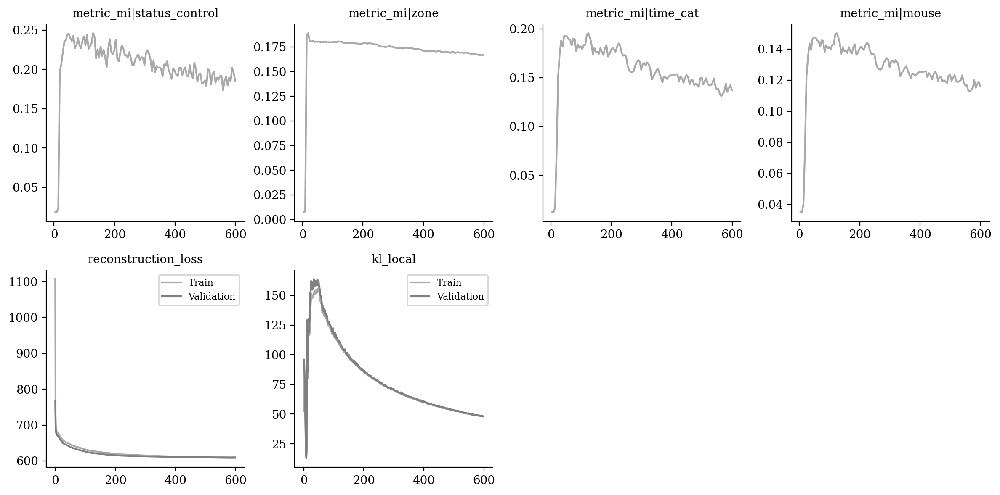

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

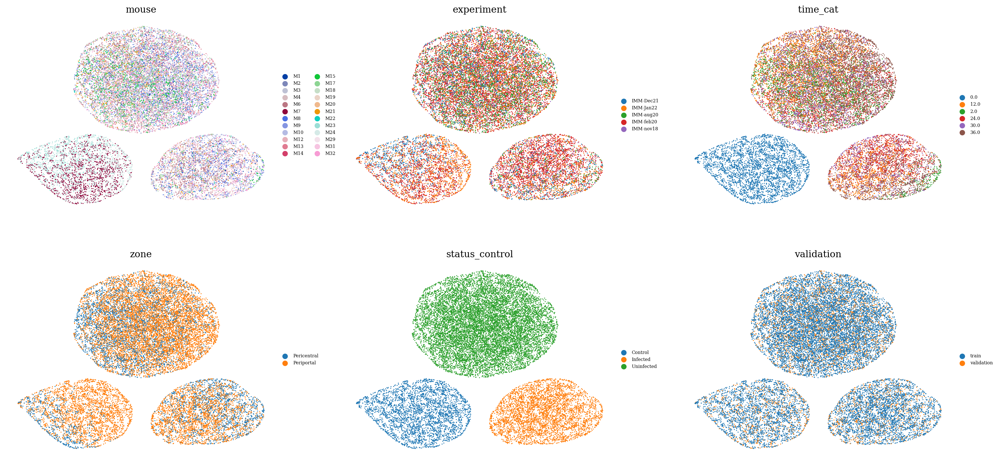

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

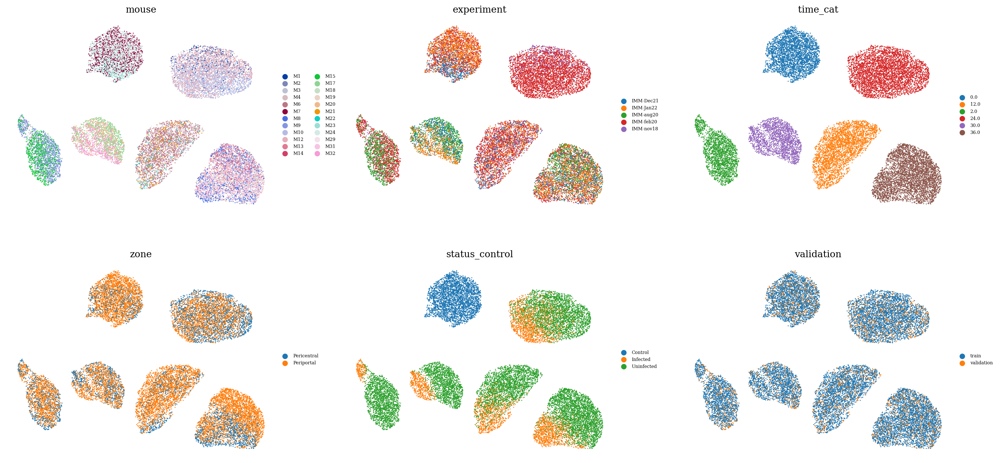

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

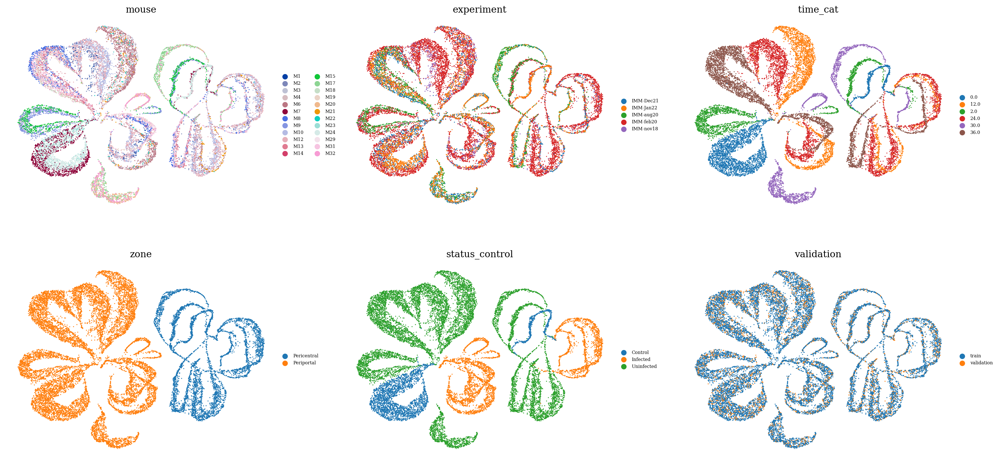

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

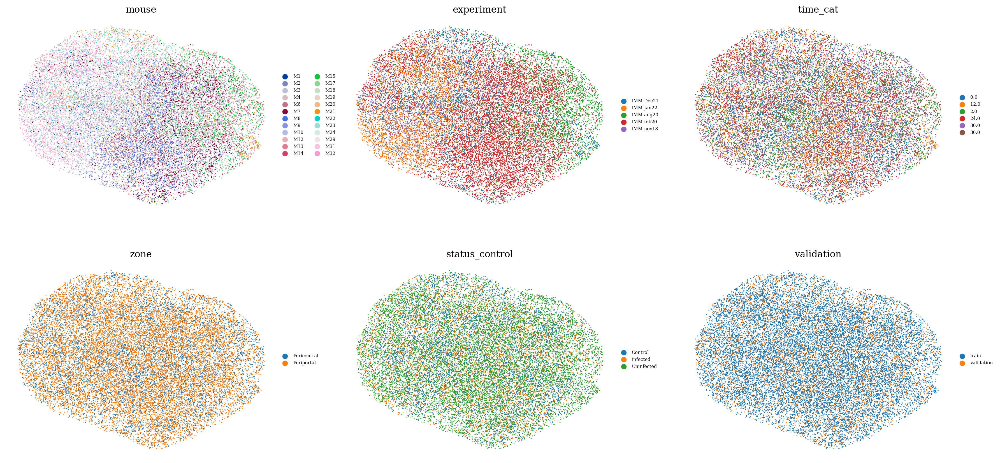

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

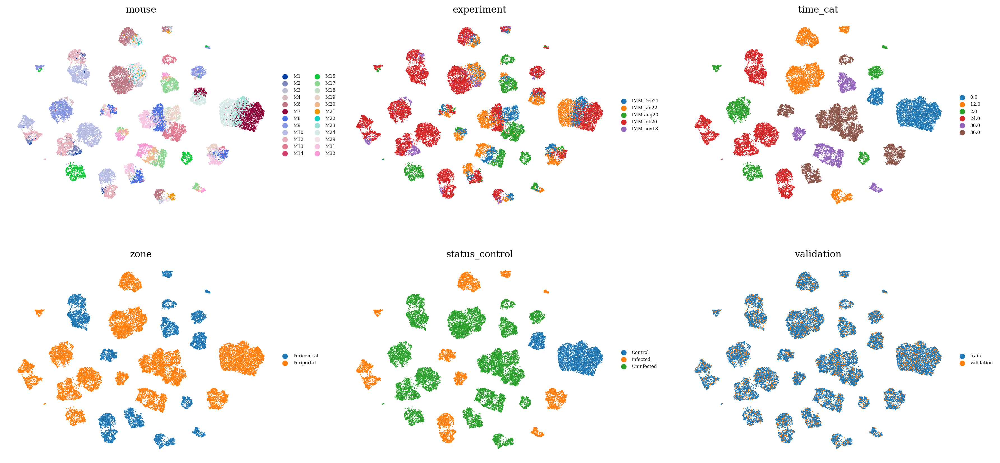

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8730331008607634

In [20]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8210152665891904